# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import torch
from ete3 import Tree
import gc
import gseapy
import seaborn as sns
import time
from scipy.spatial.distance import pdist, squareform
from statsmodels.nonparametric.smoothers_lowess import lowess

from plotting import double_tree_plot, NAN_COLOR_VALUE, nice_colors, get_tsne
from scores import get_lac_for_all_genes, get_lac_for_all_subtrees_all_genes
from model import TreeGeneModel
from training import optimize_weights
from tree_util import get_tree_dists, augment_tree_with_weights, get_node_and_edge_data

data_path = './data'
results_path = './results'

# Gene and edge weight optimization

In [2]:
def load_data(name, seed, n_cells):
  tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'

  # load data
  with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
    labels_in_order = np.array(f.read().splitlines())

  cell_meta = pd.read_csv(f'{data_path}/preprocessed/{name}_cell_types.txt', header=None)
  cell_meta.columns = ['cell_type']
  cell_meta.index = labels_in_order
  cell_meta['tumor'] = pd.read_csv(f'{data_path}/preprocessed/{name}_tumors.txt', header=None).values

  expression = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
  expression.index = labels_in_order

  # subsample
  if seed is not None:
    np.random.seed(seed)
    keep_cells = np.random.choice(labels_in_order, size=n_cells, replace=False)
    expression = expression.loc[keep_cells]
    cell_meta = cell_meta.loc[keep_cells]
    labels_in_order = keep_cells

    etree = Tree(tree_path, format=1, quoted_node_names=True)
    print('height before:', etree.get_farthest_leaf()[1])
    print('leaves before:', len(etree.get_leaves()))
    etree.prune(keep_cells.tolist())
    tree_path = f'{data_path}/preprocessed/{name}_pruned_{seed}.nwk'
    etree.write(format=1, outfile=tree_path, quoted_node_names=True)
    print('height after:', etree.get_farthest_leaf()[1])
    print('leaves after:', len(etree.get_leaves()))

  return tree_path, expression, cell_meta, labels_in_order


def reproduce_gw_ew_results(name, seed, n_cells, gamma=10):
  tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
  suffix = f'_sub_{seed}' if seed is not None else ''
  np.random.seed(12345)

  # compute scores before optimization
  tree_dists, _ = get_tree_dists(Tree(tree_path, format=1, quoted_node_names=True), labels_in_order)
  gene_scores = get_lac_for_all_genes(tree_dists, expression, decay_factor=gamma)
  gene_scores = gene_scores.sort_values('score', ascending=False)
  ordered_genes = gene_scores.index

  # compute subtree scores
  scores_subtree, scores_remaining = get_lac_for_all_subtrees_all_genes(
      tree_path, expression[ordered_genes], decay_factor=gamma, quoted_node_names=True,
      gene_group_size=100)

  gc.collect()
  torch.cuda.empty_cache()

  gene_scores.to_csv(f'{results_path}/scores/tumor/{name}_scores{suffix}.csv')
  scores_subtree.to_csv(f'{results_path}/scores/tumor/{name}_scores_subtree{suffix}.csv')
  scores_remaining.to_csv(f'{results_path}/scores/tumor/{name}_scores_remaining{suffix}.csv')

  norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))
  use_genes = ordered_genes

  # optimize just edge weights
  model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes), 
                        skip_tip_distance=-1, decay_factor=gamma, quoted_node_names=True, initial_weight=0.5)
  loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:7', gene_group_size=20)
  ew_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(), index=model.edges_ends, columns=['weight'])
  ew_df = pd.concat([ew_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
  loss_fig.show()
  ew_df.to_csv(f'{results_path}/scores/tumor/{name}_ew{suffix}.csv')

  del model
  gc.collect()
  torch.cuda.empty_cache()

  # optimize both gene and edge weights
  model = TreeGeneModel(tree_path, labels_in_order=norm_expression.index, gene_dim=len(use_genes), learn_gene_weights=True,
                        skip_tip_distance=-1, decay_factor=gamma, quoted_node_names=True, initial_weight=0.5)
  loss_fig = optimize_weights(model, norm_expression[use_genes].values, lr=1e-2, epochs=1000, device='cuda:7', gene_group_size=10)
  ewg_df = pd.DataFrame(torch.exp(model.log_edge_weights.detach()).cpu().numpy(),
                      index=model.edges_ends, columns=['weight'])
  ewg_df = pd.concat([ewg_df, pd.DataFrame(0.5 * np.ones((len(model.skip_edges_ends), 1)), index=model.skip_edges_ends, columns=['weight'])])
  gw_df = pd.DataFrame(torch.nn.functional.softmax(model.log_gene_weights.detach(), dim=0).cpu().numpy(),
                      index=use_genes, columns=['weight'])
  loss_fig.show()
  ewg_df.to_csv(f'{results_path}/scores/tumor/{name}_ewg{suffix}.csv')
  gw_df.to_csv(f'{results_path}/scores/tumor/{name}_gw{suffix}.csv')

  del model
  gc.collect()
  torch.cuda.empty_cache()

## Tumor 3515_Lkb1_T1 and its metastases

With different sub-sampling random seeds.

### Seed 19442

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


epoch: 1000; score: 459.355084093297194; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


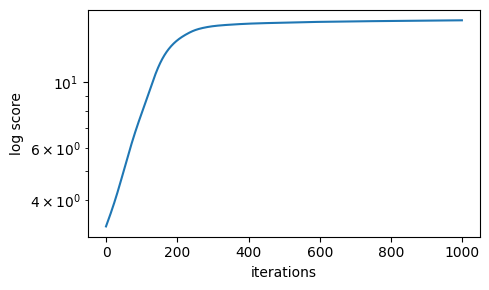

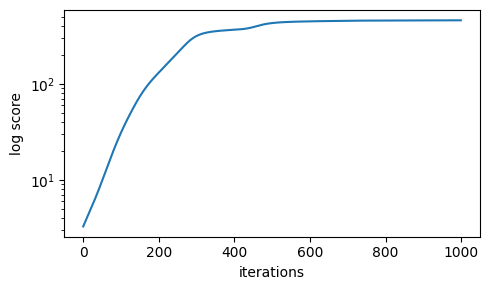

In [13]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 82712

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 408.194678160564081; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


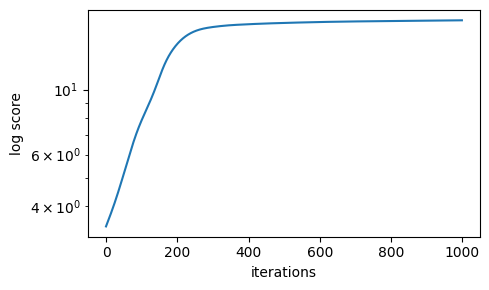

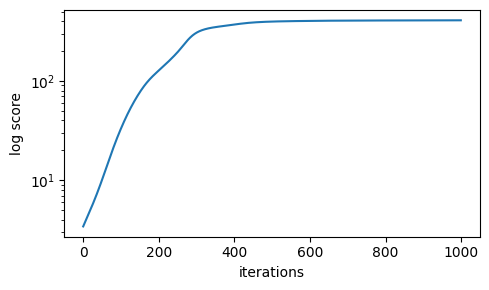

In [14]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 29873

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 653.955066550915944; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


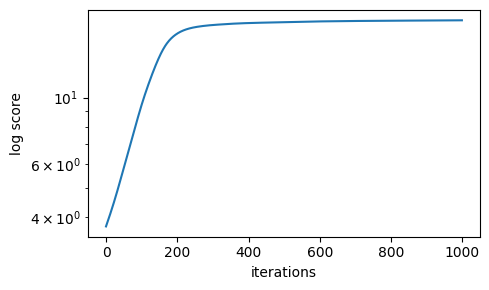

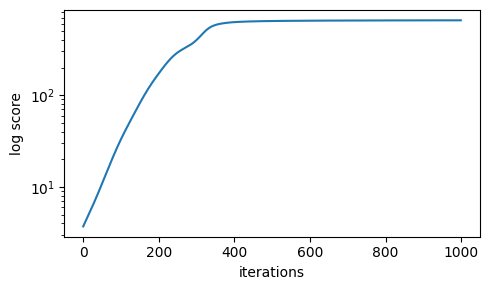

In [15]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 52382

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 608.643265827622258; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


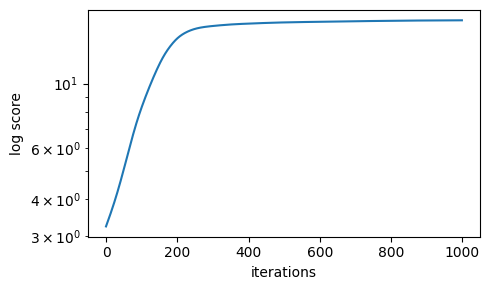

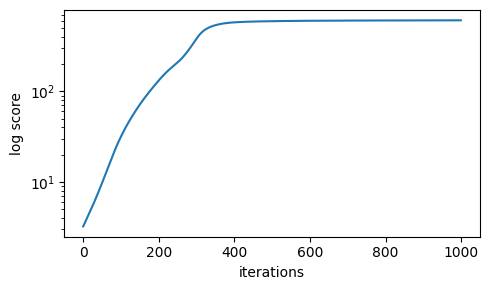

In [16]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

### Seed 79815

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 658.202600893236195; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.30it/s]


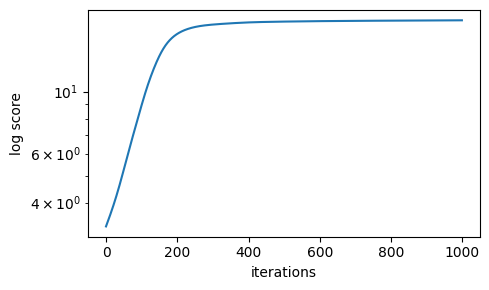

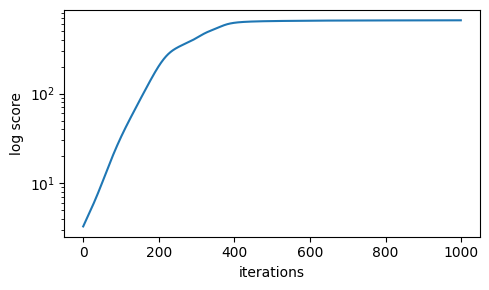

In [17]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

reproduce_gw_ew_results(name, seed, n_cells)

## Tumor 3457_Apc_T1 and its metastases

epoch: 1000; score: 404.217844434098197; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:18<00:00, 12.77it/s]


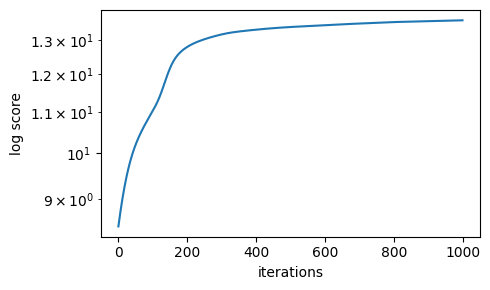

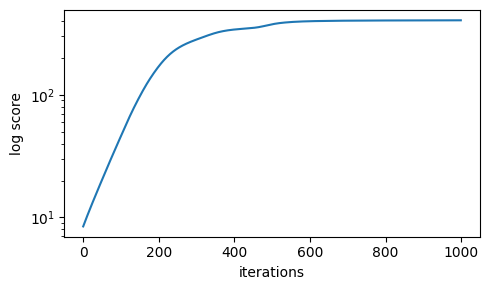

In [18]:
name = '3457_Apc_T1_Fam'

reproduce_gw_ew_results(name, seed=None, n_cells=None)

# Select genes and GO-term analysis

## Tumor 3515_Lkb1_T1 and its metastases

With different sub-sampling random seeds.

### Seed 19442 (used in Fig. 3)

In [19]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.672344,0.672344,1,agree
Sftpb,2,0.532347,0.532347,2,agree
Krt19,3,-0.539653,0.539653,3,agree
Lyz2,4,0.678393,0.678393,4,agree
...,...,...,...,...,...
Adcy9,712,0.007191,0.007191,152,score <= 1.64
Dhrs11,713,-0.018061,0.018061,167,score <= 1.64
Gcnt1,714,0.008718,0.008718,161,score <= 1.64
Kbtbd4,715,-0.027724,0.027724,147,score <= 1.64


score unsignificant at\n5% significance level    479
selected                                         146
not selected but\nscore significant               92
Name: color, dtype: int64


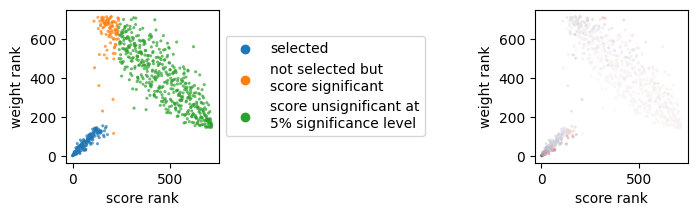

In [20]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                       'score <= 1.64':'score unsignificant at\n5% significance level',
                                                       'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [21]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()
print(selected)

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df[df['Adjusted P-value'] <= 0.05]

['Sftpc', 'Clu', 'Sftpb', 'Krt19', 'Lyz2', 'Car2', 'Klf5', 'Cldn18', 'Rpl37', 'Eif4a1', 'Krt20', 'Vcp', 'Itm2b', 'Epcam', 'Rpl35a', 'Aldoa', 'Ager', 'Mcpt1', 'Cldn4', 'Onecut2', 'Pgk1', 'Elf3', 'Rpl13', 'Hp', 'Platr10', 'Marc2', 'Foxq1', 'Hnrnpk', 'Tkt', 'Cd24a', 'H2-Aa', 'Prdx5', 'Cyba', 'Ctsa', 'Serpini1', 'Rps11', 'Atp5b', 'Eef1b2', 'Rpl41', 'Pdia4', 'Wls', 'Maged1', 'Stmn2', 'Atp2b1', 'Tff1', 'Ugdh', 'Cldn7', 'Sox17', 'Gsr', 'Tm9sf3', 'Ppp1cb', 'Hspa5', 'Krt18', 'Hmga1-rs1', 'Cd81', 'Ssrp1', 'Actr3', 'Crlf1', 'Slc34a2', 'Eef2', 'Prdx2', 'Rps18', 'Ier5', 'Rpl5', 'Hras', 'Sox4', 'Hnrnpm', 'Ifi27', 'Lamp3', 'Cxcl5', 'Sfpq', 'Hnrnpa2b1', 'Fkbp4', 'Eprs', 'Cbr1', 'Smarca5', 'S100a14', 'Ehf', 'Pvrl2', 'Plac8', 'Sumo1', 'Id3', 'G3bp2', 'Spint2', 'Il33', 'Acin1', 'Prpf40a', 'Akirin2', 'Rpl10-ps3', 'Ifitm2', 'Btf3', 'Ly6d', 'Ctnna1', 'Snrnp70', 'Lsr', 'H3f3a', 'Cited2', 'Sumo2', 'Prelid1', 'Rpl35', 'Ppp2r1a', 'Ctsh', 'Trim28', 'Anxa7', 'Spp1', 'R3hdml', 'Rsl1d1', 'Krt7', 'Rps28', 'Prpf38b',

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000006,0.002002
2,Translation (GO:0006412),0.000059,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000073,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000212,0.014151
5,Gene Expression (GO:0010467),0.000360,0.012973
6,Negative Regulation Of Apoptotic Process (GO:0...,0.002022,0.114241
7,Tight Junction Assembly (GO:0120192),0.005905,0.211689
8,Apical Junction Assembly (GO:0043297),0.005905,0.217400
9,Epithelium Development (GO:0060429),0.016079,0.659353


### Seed 82712

In [23]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.651429,0.651429,0,agree
Sftpb,2,0.538558,0.538558,3,agree
Krt19,3,-0.521188,0.521188,4,agree
Lyz2,4,0.672166,0.672166,5,agree
...,...,...,...,...,...
Zfp386,712,0.002448,0.002448,239,score <= 1.64
Plpp6,713,0.003236,0.003236,138,score <= 1.64
Ephb6,714,-0.019215,0.019215,140,score <= 1.64
Kbtbd4,715,-0.028890,0.028890,136,score <= 1.64


score unsignificant at\n5% significance level    473
selected                                         134
not selected but\nscore significant              110
Name: color, dtype: int64


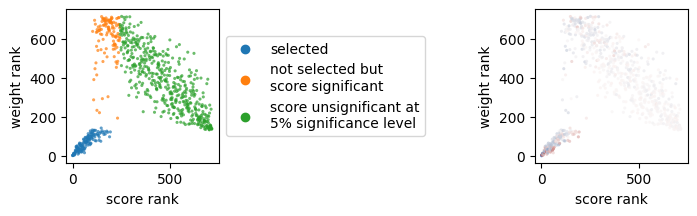

In [24]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [25]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()
print(selected)

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df[df['Adjusted P-value'] <= 0.05]

['Sftpc', 'Clu', 'Sftpb', 'Krt19', 'Lyz2', 'Car2', 'Klf5', 'Rpl35a', 'Rpl37', 'Cldn18', 'Onecut2', 'Epcam', 'Rpl13', 'Krt20', 'Aldoa', 'Ager', 'Foxq1', 'Itm2b', 'Mcpt1', 'Pgk1', 'Eif4a1', 'Hp', 'Tkt', 'Rpl5', 'Lsr', 'Tm9sf3', 'H2-Aa', 'Cd81', 'Rpl41', 'Hmga1-rs1', 'Cyba', 'Vcp', 'Rps11', 'Cldn4', 'Sox4', 'Cd24a', 'Atp2b1', 'Platr10', 'Serpini1', 'Ifi27', 'Pdia4', 'Id3', 'Elf3', 'Marc2', 'Ssrp1', 'Eef2', 'Rps18', 'Eef1b2', 'Hnrnpk', 'Cbr1', 'Spint2', 'Ugdh', 'Crlf1', 'Hspa5', 'Ctsa', 'Ly6d', 'G3bp2', 'Slc34a2', 'Prdx2', 'Prdx5', 'Cldn7', 'Rpl35', 'Lamp3', 'Actr3', 'Krt18', 'Stmn2', 'Egfl6', 'Ppib', 'Ehf', 'Atp5b', 'Cxcl5', 'Plac8', 'Trim28', 'Hras', 'Slc45a3', 'Btf3', 'Ctnna1', 'Ppp2r1a', 'Fkbp4', 'Rps28', 'Sfpq', 'Tmbim1', 'Ifitm2', 'Matn4', 'Mecom', 'S100a14', 'Serpinb6b', 'Tomm20', 'Grina', 'Sox17', 'Pvrl2', 'Fuca1', 'Mat2a', 'Maged1', 'Ctsh', 'Hnrnpm', 'Siva1', 'Psmc4', 'Slc7a4', 'Smarca5', 'Atp6ap1', 'Sumo2', 'Akr1b3', 'Mycbp', 'S100a6', 'R3hdml', 'Acin1', 'Myb', 'Prpf40a', 'Prelid

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),6.490503e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),2.139675e-05,0.002002
2,Translation (GO:0006412),1.709174e-04,0.018059
3,Gene Expression (GO:0010467),1.851960e-04,0.012973
4,Peptide Biosynthetic Process (GO:0043043),2.378585e-04,0.014151
5,Positive Regulation Of Peptidase Activity (GO:...,3.115354e-03,0.014151
6,Negative Regulation Of Apoptotic Process (GO:0...,3.115354e-03,0.114241
7,Calcium-Independent Cell-Cell Adhesion Via Pla...,3.266529e-02,0.447485
8,Tight Junction Assembly (GO:0120192),4.619182e-02,0.211689
9,Apical Junction Assembly (GO:0043297),4.619182e-02,0.217400


### Seed 29873

In [26]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 210) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,5,agree
Clu,1,-0.661422,0.661422,11,agree
Sftpb,2,0.532827,0.532827,14,agree
Krt19,3,-0.551284,0.551284,6,agree
Car2,4,-0.446704,0.446704,13,agree
...,...,...,...,...,...
4732490B19Rik,712,-0.043440,0.043440,153,score <= 1.64
Chst9,713,-0.017068,0.017068,171,score <= 1.64
Il6,714,0.013758,0.013758,141,score <= 1.64
Nkx2-6,715,-0.022315,0.022315,174,score <= 1.64


score unsignificant at\n5% significance level    466
selected                                         143
not selected but\nscore significant              108
Name: color, dtype: int64


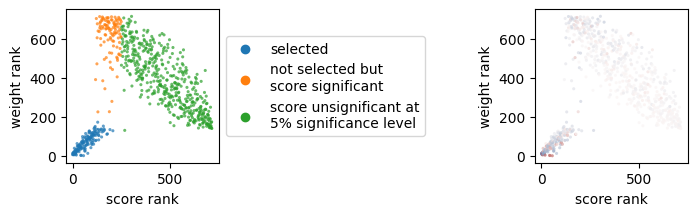

In [27]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [28]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()
print(selected)

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df[df['Adjusted P-value'] <= 0.05]

['Sftpc', 'Clu', 'Sftpb', 'Krt19', 'Car2', 'Lyz2', 'Klf5', 'Cldn18', 'Krt20', 'Aldoa', 'Itm2b', 'Rpl37', 'Rpl35a', 'Epcam', 'Onecut2', 'Ctsa', 'Cd24a', 'Eif4a1', 'Cyba', 'Ager', 'Cldn4', 'Hnrnpk', 'Pdia4', 'Mcpt1', 'Pgk1', 'Tm9sf3', 'Cd81', 'Hp', 'Rpl13', 'Rpl41', 'Vcp', 'Atp2b1', 'Ssrp1', 'Spint2', 'Ppp1cb', 'Cldn7', 'Marc2', 'Ppib', 'Elf3', 'Hmga1-rs1', 'Sox17', 'Foxq1', 'H2-Aa', 'Rps11', 'Slc34a2', 'Ifi27', 'Stmn2', 'Rpl5', 'Crlf1', 'Serpini1', 'Pvrl2', 'Vps37d', 'Tkt', 'Platr10', 'Wls', 'Cbr1', 'Lamp3', 'Eef1b2', 'Id3', 'Hspa5', 'Lsr', 'Atp5b', 'Nucb1', 'Gsr', 'Krt18', 'Ugdh', 'Prpf40a', 'Plppr4', 'Sfpq', 'Ly6d', 'Actr3', 'Rps18', 'Sox4', 'Prdx2', 'Mrpl24', 'Eif6', 'Egfl6', 'Smarca5', 'Ifitm2', 'Sumo1', 'Trim28', 'Rpl35', 'Plac8', 'S100a14', 'H3f3a', 'Yipf4', 'Wbp5', 'Prdx5', 'Mecom', 'Hras', 'Maged1', 'Acin1', 'Ppp2r1a', 'Ctnna1', 'Fkbp4', 'R3hdml', 'Sbds', 'Eef2', 'Hnrnpm', 'Hnrnpa2b1', 'Tff1', 'Anapc5', 'G3bp2', 'Cox6a2', 'Cxcl5', 'Elavl1', 'Sumo2', 'Ewsr1', 'Ctsh', 'Il33', 'Peb

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),6.687970e-07,0.002002
1,Cytoplasmic Translation (GO:0002181),6.687970e-07,0.182657
2,Translation (GO:0006412),4.961410e-06,0.018059
3,Peptide Biosynthetic Process (GO:0043043),5.015736e-06,0.014151
4,Gene Expression (GO:0010467),6.185268e-06,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,5.076451e-03,0.014151
6,Positive Regulation Of Amide Metabolic Process...,5.101615e-03,0.127855
7,Protein Stabilization (GO:0050821),1.728202e-02,0.232433
8,Negative Regulation Of Apoptotic Process (GO:0...,2.200937e-02,0.114241
9,Positive Regulation Of Macromolecule Biosynthe...,2.659137e-02,0.366372


### Seed 52382

In [29]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.648489,0.648489,4,agree
Krt19,2,-0.531977,0.531977,3,agree
Sftpb,3,0.505823,0.505823,5,agree
Lyz2,4,0.668199,0.668199,6,agree
...,...,...,...,...,...
Wfs1,712,-0.002840,0.002840,172,score <= 1.64
M1ap,713,-0.036859,0.036859,143,score <= 1.64
Armc5,714,-0.038982,0.038982,191,score <= 1.64
Ephb6,715,-0.044356,0.044356,176,score <= 1.64


score unsignificant at\n5% significance level    473
selected                                         144
not selected but\nscore significant              100
Name: color, dtype: int64


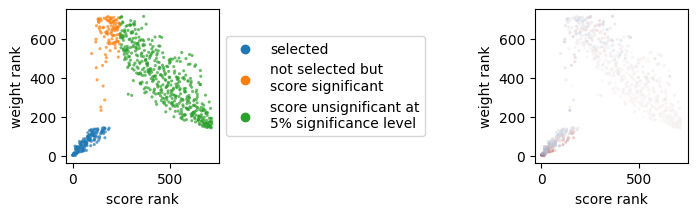

In [30]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [31]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()
print(selected)

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df[df['Adjusted P-value'] <= 0.05]

['Sftpc', 'Clu', 'Krt19', 'Sftpb', 'Lyz2', 'Car2', 'Klf5', 'Cldn18', 'Rpl35a', 'Epcam', 'Rpl37', 'Itm2b', 'Mcpt1', 'Eif4a1', 'Ager', 'Aldoa', 'Tkt', 'Ctsa', 'Hnrnpk', 'Krt20', 'Onecut2', 'Foxq1', 'Pgk1', 'Cyba', 'Cd81', 'Rpl13', 'Marc2', 'Cd24a', 'Vcp', 'Cldn4', 'Spint2', 'Hspa5', 'Rpl41', 'Ifi27', 'Sox17', 'Platr10', 'Tm9sf3', 'Atp2b1', 'Hp', 'Elf3', 'Serpini1', 'Slc34a2', 'Ppib', 'Maged1', 'Actr3', 'Krt18', 'Hmga1-rs1', 'Pvrl2', 'H2-Aa', 'Eef1b2', 'Prpf40a', 'Fkbp4', 'Eef2', 'Atp5b', 'Tff1', 'Rps11', 'Sox4', 'Rps18', 'Cxcl5', 'Lamp3', 'Crlf1', 'Ly6d', 'Rpl5', 'Ppp1cb', 'Cldn7', 'Stmn2', 'Sbds', 'Prdx5', 'Ehf', 'Ugdh', 'Pdia4', 'Rpl35', 'Spp1', 'Cbr1', 'Ifitm2', 'Hnrnpa2b1', 'Ppp2r1a', 'R3hdml', 'Slc45a3', 'Trim28', 'Rps28', 'Nucb1', 'Il33', 'G3bp2', 'Prdx2', 'Eif6', 'Rpl9-ps6', 'Vps37d', 'Id3', 'Smarca5', 'Hnrnpm', 'Lsr', 'S100a14', 'Gsr', 'Plppr4', 'Ssrp1', 'Btf3', 'Iscu', 'Wls', 'Sumo1', 'Impdh2', 'Psmc4', 'Zbtb7a', 'Akirin2', 'Sfpq', 'Rnh1', 'Ctnna1', 'Matn4', 'Atp5e', 'Slc37a1', 

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000001,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000005,0.002002
2,Translation (GO:0006412),0.000048,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000060,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000187,0.014151
5,Gene Expression (GO:0010467),0.000293,0.012973
6,Tight Junction Assembly (GO:0120192),0.005218,0.211689
7,Positive Regulation Of Cellular Respiration (G...,0.005218,0.269699
8,Apical Junction Assembly (GO:0043297),0.005218,0.217400
9,Negative Regulation Of Apoptotic Process (GO:0...,0.021402,0.114241


### Seed 79815

In [32]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,6,agree
Clu,1,-0.652748,0.652748,11,agree
Sftpb,2,0.553042,0.553042,9,agree
Krt19,3,-0.554289,0.554289,7,agree
Lyz2,4,0.700920,0.700920,8,agree
...,...,...,...,...,...
Arhgap40,712,-0.007445,0.007445,156,score <= 1.64
Rnmtl1,713,-0.011296,0.011296,164,score <= 1.64
1810014B01Rik,714,0.003474,0.003474,176,score <= 1.64
Gm26609,715,-0.007169,0.007169,152,score <= 1.64


score unsignificant at\n5% significance level    476
selected                                         150
not selected but\nscore significant               91
Name: color, dtype: int64


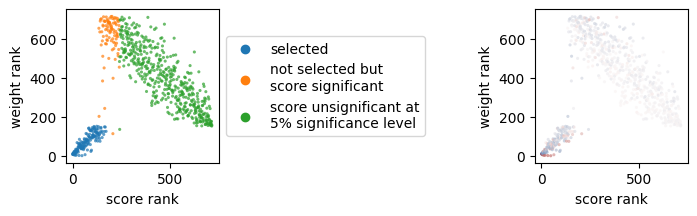

In [33]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [34]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()
print(selected)

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df[df['Adjusted P-value'] <= 0.05]

['Sftpc', 'Clu', 'Sftpb', 'Krt19', 'Lyz2', 'Car2', 'Klf5', 'Cldn18', 'Krt20', 'Eif4a1', 'Rpl35a', 'Epcam', 'Rpl37', 'Itm2b', 'Ager', 'Onecut2', 'Aldoa', 'Hspa5', 'Vcp', 'H2-Aa', 'Cd24a', 'Hp', 'Cd81', 'Mcpt1', 'Spint2', 'Atp5b', 'Rpl13', 'Hnrnpk', 'Elf3', 'Cyba', 'Hmga1-rs1', 'Atp2b1', 'Pgk1', 'Slc34a2', 'Tkt', 'Platr10', 'Actr3', 'Foxq1', 'Maged1', 'Sfpq', 'Tm9sf3', 'Stmn2', 'Lsr', 'Cldn7', 'Eef1b2', 'Sox17', 'Krt18', 'Eef2', 'Lamp3', 'Marc2', 'Rpl41', 'Cldn4', 'Tff1', 'Rps18', 'Ctsa', 'Prdx5', 'Ugdh', 'Rpl5', 'Ifi27', 'Hnrnpa2b1', 'Akirin2', 'Crlf1', 'Pdia4', 'Serpini1', 'Egfl6', 'Prdx2', 'Cbr1', 'Rps11', 'Plac8', 'Stard3nl', 'Ly6d', 'Sumo1', 'Rps28', 'Spp1', 'Trpm5', 'Ppp1cb', 'Fkbp4', 'Cxcl5', 'Rpl35', 'Id3', 'Sox4', 'Ppp2r1a', 'H2afj', 'Sumo2', 'Hnrnpm', 'Ppp1cc', 'Ssrp1', 'Ehf', 'Ier2', 'Smarca5', 'Ctsd', 'Ctsh', 'Eif6', 'Wls', 'Gsr', 'Nucb1', 'Mecom', 'Ifitm2', 'Atp5e', 'S100a14', 'Pvrl2', 'Arl1', 'Capza2', 'Ctnna1', 'H3f3a', 'Prpf40a', 'Serpinb6b', 'Slc45a3', 'Acin1', 'Trim28',

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000079,0.002002
2,Positive Regulation Of Peptidase Activity (GO:...,0.000399,0.014151
3,Translation (GO:0006412),0.000455,0.018059
4,Peptide Biosynthetic Process (GO:0043043),0.000702,0.014151
5,Gene Expression (GO:0010467),0.002851,0.012973
6,Protein Stabilization (GO:0050821),0.004589,0.232433
7,Positive Regulation Of Amide Metabolic Process...,0.005983,0.127855
8,Tight Junction Assembly (GO:0120192),0.005983,0.211689
9,Apical Junction Assembly (GO:0043297),0.005983,0.217400


## Tumor 3457_Apc_T1 and its metastases (used in S12)

In [80]:
name = '3457_Apc_T1_Fam'

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed=None, n_cells=None)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 150) & (gene_rank_df['weight rank'] < 150), 'color'] = 'agree'
gene_rank_df

,score rank,Scgb1a1 corr,Scgb1a1 abs corr,weight rank,color
Scgb1a1,0,NaN,NaN,8,agree
Epcam,1,0.346919,0.346919,0,agree
Krt7,2,0.540090,0.540090,5,agree
Stmn2,3,-0.330289,0.330289,4,agree
Cldn7,4,0.356227,0.356227,1,agree
...,...,...,...,...,...
Tab3,610,-0.002437,0.002437,102,score <= 1.64
A330017A19Rik,611,-0.016059,0.016059,105,score <= 1.64
Card19,612,-0.019740,0.019740,117,score <= 1.64
Ly75,613,0.011505,0.011505,108,score <= 1.64


score unsignificant at\n5% significance level    324
not selected but\nscore significant              190
selected                                         101
Name: color, dtype: int64


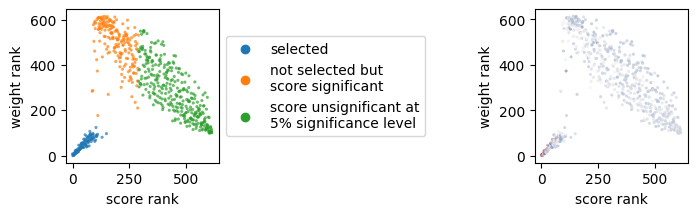

In [81]:
gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [82]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),0.000149,0.000133
1,Cytoplasmic Translation (GO:0002181),0.000149,0.081720
2,Translation (GO:0006412),0.000637,0.003073
3,Tight Junction Assembly (GO:0120192),0.000944,0.250113
4,Positive Regulation Of Peptidase Activity (GO:...,0.000944,0.003978
5,Peptide Biosynthetic Process (GO:0043043),0.001710,0.003978
6,Gene Expression (GO:0010467),0.001809,0.000672
7,Bicellular Tight Junction Assembly (GO:0070830),0.007641,0.323665
8,Calcium-Independent Cell-Cell Adhesion Via Pla...,0.008314,0.323665
9,Regulation Of Cell Population Proliferation (G...,0.008314,0.140305


# Figure 3 and S10

In [35]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


In [36]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575, line_width=2)

alt.HConcatChart(...)

In [37]:
additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain, line_width=2,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [38]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

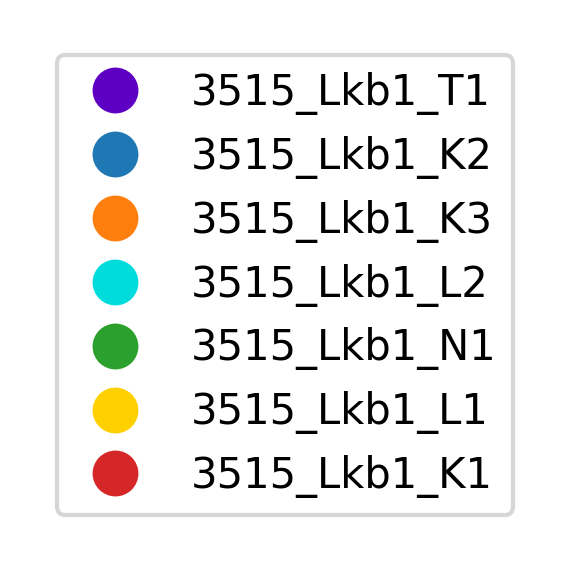

In [39]:
from matplotlib.lines import Line2D

color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=1)
fig.tight_layout()

/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


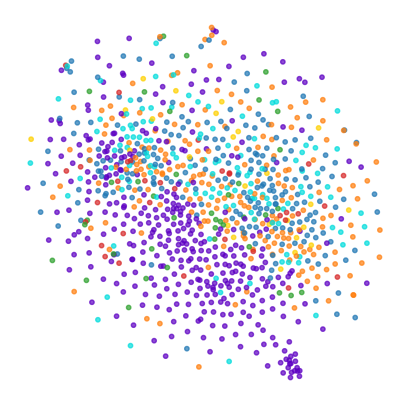

In [40]:
points = get_tsne(norm_expression)

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
ax.scatter(points[:, 0], points[:, 1],
           c=color_df.loc[cell_meta.loc[norm_expression.index]['tumor']].values.flatten(),
           alpha=0.7, s=10)
ax.axis('off')
fig.show()

In [42]:
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df

array(['Macromolecule Biosynthetic Process (GO:0009059)',
       'Gene Expression (GO:0010467)',
       'Peptide Biosynthetic Process (GO:0043043)',
       'Positive Regulation Of Peptidase Activity (GO:0010952)',
       'RNA Processing (GO:0006396)', 'Translation (GO:0006412)',
       'Growth Hormone Receptor Signaling Pathway Via JAK-STAT (GO:0060397)',
       'Formation Of Cytoplasmic Translation Initiation Complex (GO:0001732)'],
      dtype=object)


,Adjusted P-value using selected genes (82712),Adjusted P-value using selected genes (29873),Adjusted P-value using selected genes (52382),Adjusted P-value using selected genes (19442),Adjusted P-value using selected genes (79815),Avg. adjusted P-value using selected genes,Adjusted P-value using all expressed genes
Term,,,,,,,
Cytoplasmic Translation (GO:0002181),6.490503e-07,6.687970e-07,0.000001,0.000002,0.000002,0.000001,0.182657
Macromolecule Biosynthetic Process (GO:0009059),2.139675e-05,6.687970e-07,0.000005,0.000006,0.000079,0.000022,0.002002
Translation (GO:0006412),1.709174e-04,4.961410e-06,0.000048,0.000059,0.000455,0.000148,0.018059
Peptide Biosynthetic Process (GO:0043043),2.378585e-04,5.015736e-06,0.000060,0.000073,0.000702,0.000216,0.014151
Gene Expression (GO:0010467),1.851960e-04,6.185268e-06,0.000293,0.000360,0.002851,0.000739,0.012973
...,...,...,...,...,...,...,...
Positive Regulation Of Cell Differentiation (GO:0045597),8.571342e-01,8.746970e-01,0.877307,0.879136,0.886108,0.874876,0.864839
Protein Modification Process (GO:0036211),9.923007e-01,9.650136e-01,0.966066,0.779636,0.908012,0.922206,0.794532
Organelle Organization (GO:0006996),9.444191e-01,9.543947e-01,0.955382,0.956379,0.830800,0.928275,0.788148


/tmp/ipykernel_3995389/2171891641.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'


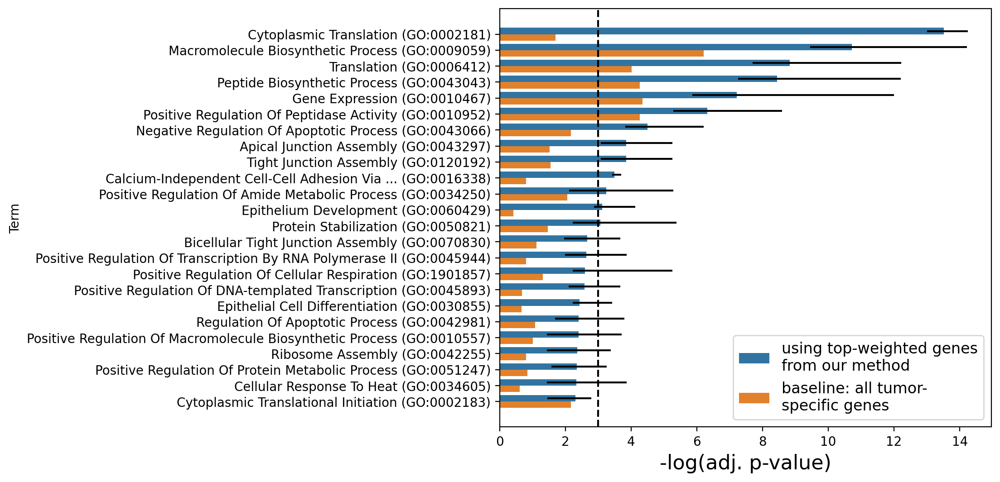

In [43]:
df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
assert df['Term'].loc[9] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df.apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
mdf.loc[0:len(df)-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'low'] -= (-df[df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:len(df)-1, 'up'] += (-df[df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all tumor-\nspecific genes'})

fig, ax = plt.subplots(dpi=200, figsize=(7, 6))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')

/tmp/ipykernel_4025792/2401570328.py:15: RuntimeWarning: invalid value encountered in sqrt
  adj_gene_counts = (gene_counts - gene_counts.mean(axis=0)) / np.sqrt(gene_stats['pred var'].values)


values to clip: Sox17      0
Tcea1      0
St18       0
Tram1      0
Sdhaf4     0
          ..
Mrpl43     0
Cuedc2     0
Neurl1a    0
Mirt1      0
mt-Nd2     0
Length: 717, dtype: int64
['S100a6' 'Sftpc' 'Ly6d' 'Tff1' 'Car2' 'Sftpb' 'Il33' 'Actb' 'Krt19'
 'Spp1' 'Cxcl5' 'Areg' 'Stmn2' 'Gnat3' 'Lyz2' 'Krt18' 'Mcpt1' 'Plac8'
 'Ager' 'Slc34a2' 'Crlf1' 'Hp' 'Hmga1-rs1' 'Igfbpl1' 'Trpm5' 'Krt20'
 'Nefl' 'Cldn18' 'Cldn4' 'H2-Aa' 'Id3' 'S100a14' 'St18' 'Onecut2' 'Btg2'
 'Tesc' 'Lamp3' 'Sox4' 'Cited2' 'Pgk1' 'Krt7' 'Foxe1' 'Foxq1' 'Rpl13'
 'Far1' 'Ctsh' 'Egfl6' 'Egr1' 'Cebpb' 'Cox6a2' 'Tspan1' 'Klf5' 'Ugdh'
 'Ier2' 'Bex4' 'Cldn3' 'Ucp2' 'Rpl41' 'Sox17' 'A630076J17Rik' 'Fosb'
 'Ifi27' 'Serpinb6b' 'Il6' 'Elf3' 'Cited4' 'Hist1h2ap' 'Tkt' 'Ier5'
 'Mgst1' 'Pttg1' 'Hmgn5' 'Srm' 'Gnl3' 'Akr1b3' 'Maff' 'Fstl1' 'Ctsl'
 'Ovol1' 'Ahnak' 'Slc25a4' 'Cxcl10' 'Hspa5' 'Cd24a' 'Sms' 'Plppr4'
 'R3hdml' 'Siva1' 'Pdlim7' 'Dctpp1' 'Dnm1l' 'Sertad1' 'Pbdc1' 'Zcchc9'
 'Scgb1a1' 'Nradd' 'Adora1' 'Aldob' 'Actn1' 'Vma21

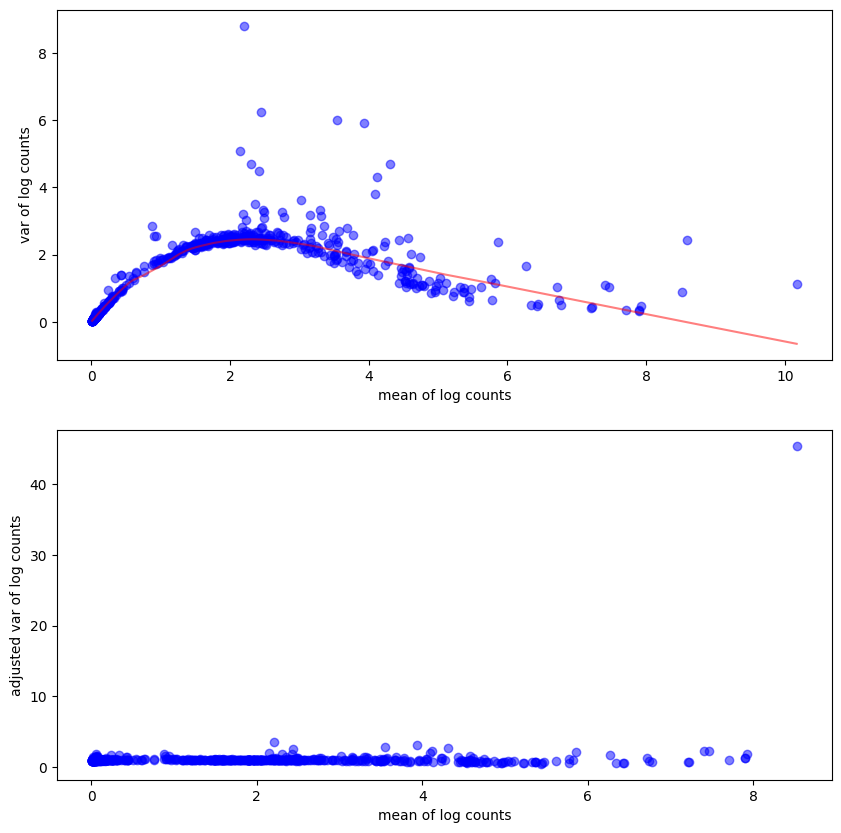

In [3]:
def get_hvg_genes(gene_counts):
  gene_stats = pd.DataFrame()
  gene_stats.index = gene_counts.columns
  gene_stats['mean'] = gene_counts.mean(axis=0)
  gene_stats['var'] = gene_counts.var(axis=0)
  gene_stats['pred var'] = lowess(gene_stats['var'], gene_stats['mean'], return_sorted=False, frac=1/3)

  fig, (ax, ax2) = plt.subplots(2, 1, figsize=(10, 10))
  ax.plot(gene_stats['mean'], gene_stats['var'], 'ob', alpha=0.5)
  gene_stats_sorted = gene_stats.sort_values('mean')
  ax.plot(gene_stats_sorted['mean'], gene_stats_sorted['pred var'], '-r', alpha=0.5)
  ax.set_xlabel('mean of log counts')
  ax.set_ylabel('var of log counts')

  adj_gene_counts = (gene_counts - gene_counts.mean(axis=0)) / np.sqrt(gene_stats['pred var'].values)
  print('values to clip:', (np.abs(adj_gene_counts) > np.sqrt(len(gene_counts))).sum())
  adj_gene_counts = np.clip(adj_gene_counts, -np.sqrt(len(gene_counts)), np.sqrt(len(gene_counts)))

  gene_stats['adj. var'] = adj_gene_counts.var(axis=0)
  gene_stats = gene_stats.sort_values('adj. var', ascending=False)

  ax2.plot(gene_stats['mean'], gene_stats['adj. var'], 'ob', alpha=0.5)
  ax2.set_xlabel('mean of log counts')
  ax2.set_ylabel('adjusted var of log counts')
  fig.show()

  return gene_stats.index.values


name = '3515_Lkb1_T1_Fam'
gene_counts = pd.read_csv(f'{data_path}/preprocessed/{name}_normalized_log_counts.txt')
with open(f'{data_path}/preprocessed/{name}_cells.txt') as f:
  labels_in_order = np.array(f.read().splitlines())
gene_counts.index = labels_in_order

hvg_genes = get_hvg_genes(gene_counts)[:100]
print(hvg_genes)

# standardize
gene_counts = (gene_counts - np.mean(gene_counts, axis=0))/np.std(gene_counts, axis=0)

tree_path = f'{data_path}/preprocessed/{name}_pruned.nwk'
tree_dists, mrca_depths = get_tree_dists(Tree(tree_path, format=1, quoted_node_names=True), labels_in_order)

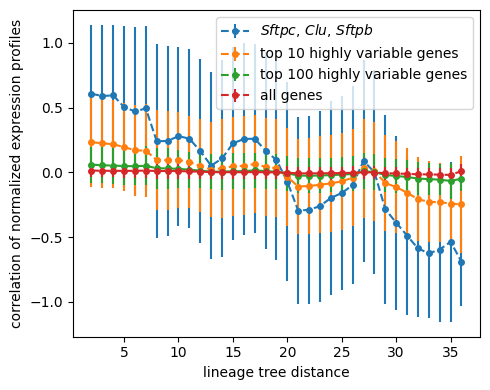

In [4]:
overall = gene_counts.values
corr_dists = 1 - squareform(pdist(overall, metric='correlation'))

top3 = gene_counts[['Sftpc', 'Clu', 'Sftpb']].values
top3_corr_dists = 1 - squareform(pdist(top3, metric='correlation'))

hvg = gene_counts[hvg_genes].values
hvg_corr_dists = 1 - squareform(pdist(hvg, metric='correlation'))

hvg10 = gene_counts[hvg_genes[:10]].values
hvg10_corr_dists = 1 - squareform(pdist(hvg10, metric='correlation'))

gene_tree_dist = pd.DataFrame()
gene_tree_dist['tree dist'] = np.triu(tree_dists).flatten().astype(int)
gene_tree_dist['mrca depth'] = np.triu(mrca_depths).flatten().astype(int)
gene_tree_dist['expression correlation'] = corr_dists.flatten()
gene_tree_dist['top 3 expression correlation'] = top3_corr_dists.flatten()
gene_tree_dist['hvg expression correlation'] = hvg_corr_dists.flatten()
gene_tree_dist['hvg10 expression correlation'] = hvg10_corr_dists.flatten()
gene_tree_dist = gene_tree_dist[gene_tree_dist['tree dist'] != 0]  # remove lower triangle and diagonal pairs

agg = gene_tree_dist.groupby('tree dist').mean()
agg_std = gene_tree_dist.groupby('tree dist').std()

fig, ax = plt.subplots(1, 1, figsize=(5, 4))
ax.errorbar(agg.index, agg['top 3 expression correlation'], yerr=agg_std['top 3 expression correlation'], markersize=4, marker='o', fmt='--', label='$\it{Sftpc}$, $\it{Clu}$, $\it{Sftpb}$')
ax.errorbar(agg.index, agg['hvg10 expression correlation'], yerr=agg_std['hvg10 expression correlation'], markersize=4, marker='o', fmt='--', label='top 10 highly variable genes')
ax.errorbar(agg.index, agg['hvg expression correlation'], yerr=agg_std['hvg expression correlation'], markersize=4, marker='o', fmt='--', label='top 100 highly variable genes')
ax.errorbar(agg.index, agg['expression correlation'], yerr=agg_std['expression correlation'], markersize=4, marker='o', fmt='--', label='all genes')
ax.legend()
ax.set_xlabel('lineage tree distance')
ax.set_ylabel('correlation of normalized expression profiles')
fig.tight_layout()

# Figure S11

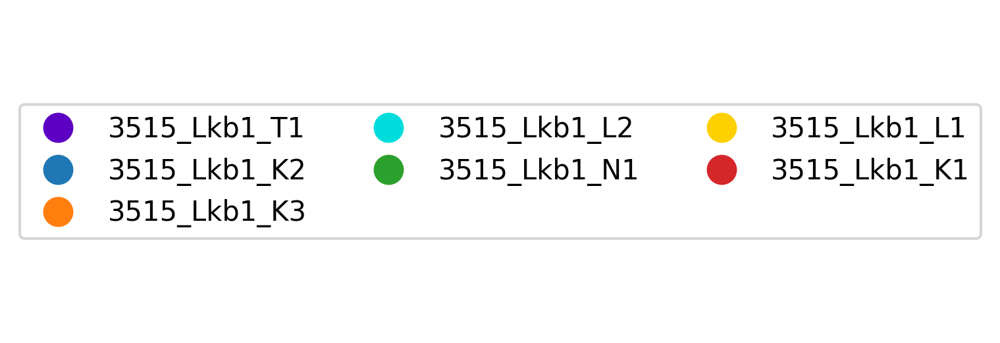

In [49]:
from matplotlib.lines import Line2D

additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=3)

### Seed 82712

In [50]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


In [51]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [52]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [53]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

### Seed 29873

In [55]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


In [56]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [57]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [58]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

### Seed 52382

In [59]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


In [60]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [61]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [62]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

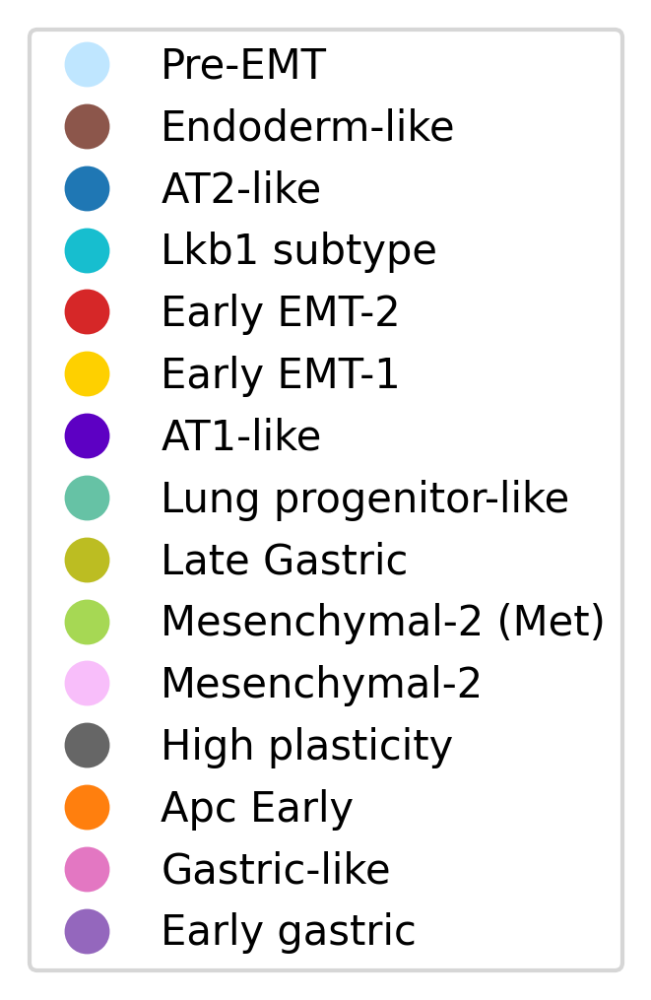

In [63]:
from matplotlib.lines import Line2D
from plotting import nice_colors, kp_color_domain

color_df = pd.DataFrame(index=kp_color_domain)
color_df['color'] = nice_colors
color_df = color_df.loc[cell_meta['cell_type'].value_counts().index]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=1)
fig.tight_layout()

### Seed 79815

In [64]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


In [65]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [66]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [67]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

# Figure S12

In [68]:
name = '3457_Apc_T1_Fam'
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed=None, n_cells=None)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

additional_color_domain = [
    '3457_Apc_T1',
    '3457_Apc_K1',
    '3457_Apc_N2'
]

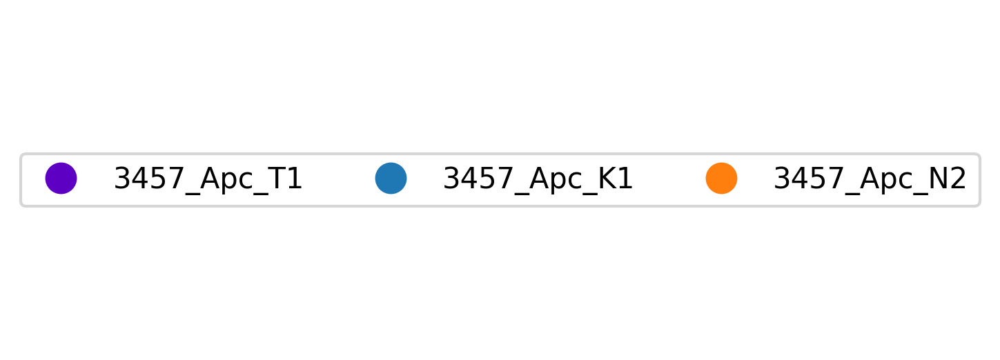

In [70]:
from matplotlib.lines import Line2D

color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=3)

/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/home/hschlueter/anaconda3/envs/myenv-38/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


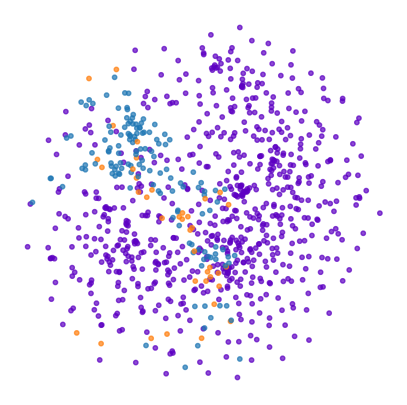

In [71]:
tsne_points = get_tsne(norm_expression)

fig, ax = plt.subplots(1, 1, figsize=(5, 5))
color_df = pd.DataFrame(index=additional_color_domain)
color_df['color'] = nice_colors[1:len(additional_color_domain)+1]
ax.scatter(tsne_points[:, 0], tsne_points[:, 1],
           c=color_df.loc[cell_meta.loc[norm_expression.index]['tumor']].values.flatten(),
           alpha=0.7, s=10)
ax.axis('off')
fig.show()

/tmp/ipykernel_3995389/301157115.py:15: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout()


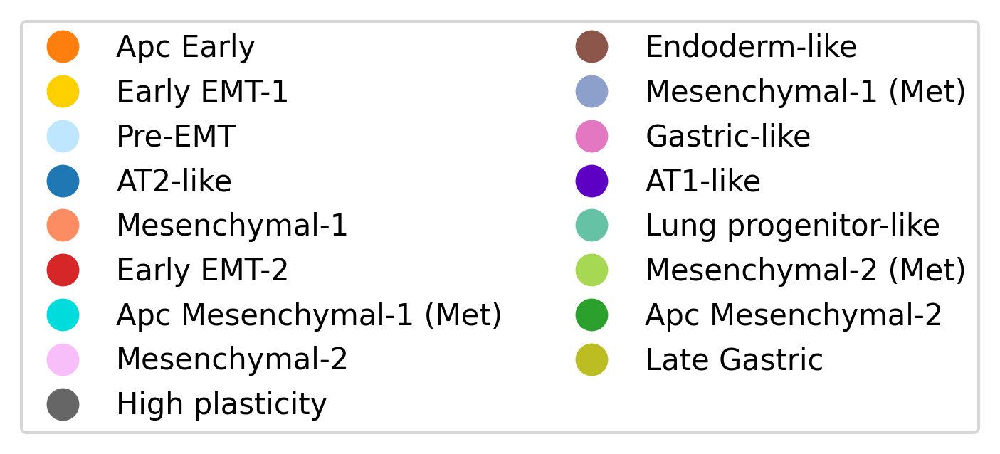

In [72]:
from matplotlib.lines import Line2D
from plotting import nice_colors, kp_color_domain

color_df = pd.DataFrame(index=kp_color_domain)
color_df['color'] = nice_colors
color_df = color_df.loc[cell_meta['cell_type'].value_counts().index]
legend_elements = []
for color, cell_type in zip(color_df['color'], color_df.index):
  legend_elements.append(Line2D([0], [0], marker='o', lw=0, color=color, label=cell_type, markersize=10))

# Create the figure
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis('off')
ax.legend(handles=legend_elements, loc='center', ncol=2)
fig.tight_layout()

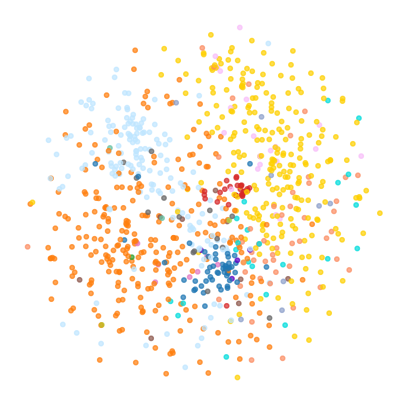

In [73]:
fig, ax = plt.subplots(1, 1, figsize=(5, 5))
ax.scatter(tsne_points[:, 0], tsne_points[:, 1],
           c=color_df.loc[cell_meta.loc[norm_expression.index]['cell_type']].values.flatten(),
           alpha=0.7, s=10)
ax.axis('off')
fig.show()

In [74]:
gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

In [75]:
double_tree_plot(nodes, edges, cell_labels=node_labels,
                 colors=[np.concatenate([norm_expression[gene], NAN_COLOR_VALUE * np.ones(len(scores_subtree))]) for gene in show_genes] + [
                                         np.concatenate([NAN_COLOR_VALUE * np.ones(len(norm_expression)), scores_subtree[gene].clip(upper=10)]) for gene in show_genes] + [
                                         ewg_df.loc[node_labels, 'weight']],
                 color_names=[f'{gene} expression' for gene in show_genes] + [f'{gene} subtree score' for gene in show_genes] + ['incoming edge weight'],
                 tooltip_names=['cell_label', 'incoming edge weight'],
                 show_legend=True, continuous_colors=True, width=575)

alt.HConcatChart(...)

In [76]:
double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [77]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

/tmp/ipykernel_3995389/481028558.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[8] = 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane\nCell-Adhesion Molecules (GO:0016338)'


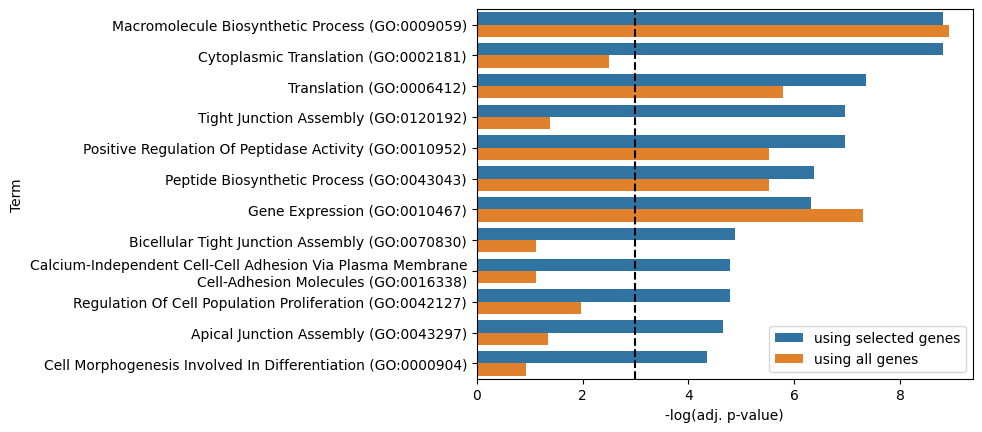

In [83]:
df = (-pd.read_csv(f'{results_path}/genes/{name}_selected_genes.csv').rename(
    columns={'Adjusted P-value':'using selected genes', 'Adjusted P-value using all genes':'using all genes'}
).set_index('Term').apply(np.log)).reset_index()

assert df['Term'].loc[8] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[8] = 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane\nCell-Adhesion Molecules (GO:0016338)'

df = df.sort_values('using selected genes', ascending=False)

mdf = pd.melt(df, id_vars=['Term'], value_vars=['using selected genes', 'using all genes'], value_name='-log(adj. p-value)')
sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable')
plt.gca().legend().set_title('')
plt.axvline(-np.log(0.05), color='k', ls='--')

# Figure S18 (gene and edge weight optimization parts)

## Gene and edge weight optimization

With different sub-sampling random seeds.

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


epoch: 1000; score: 651.917663046686243; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 669.060240261657896; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.31it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 656.776634923055099; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:01<00:00,  8.26it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 610.491229396334916; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 646.457911254875626; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.27it/s]


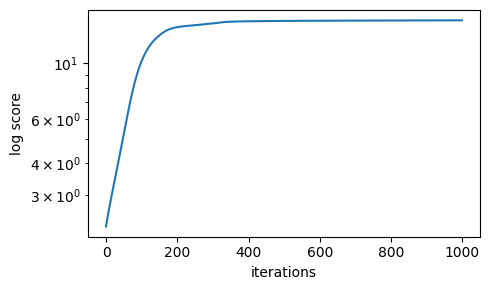

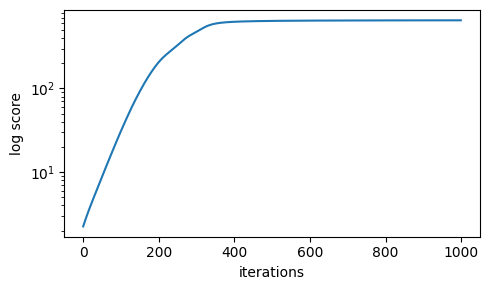

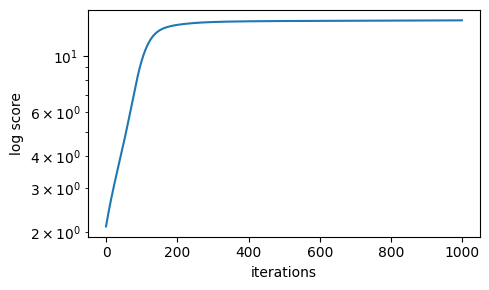

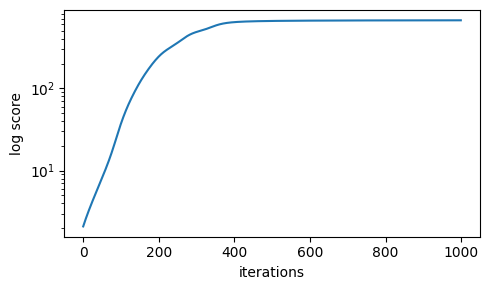

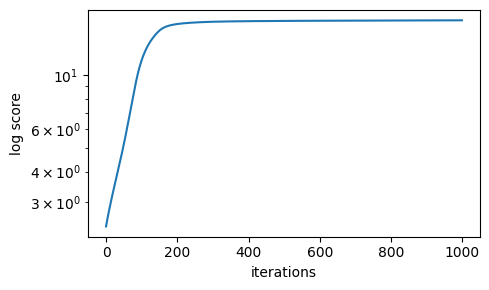

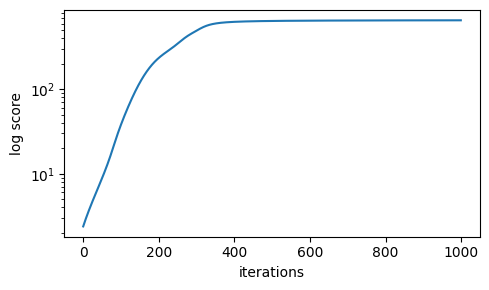

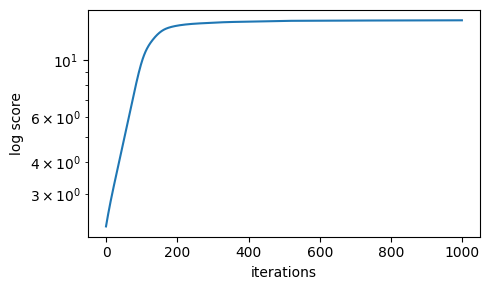

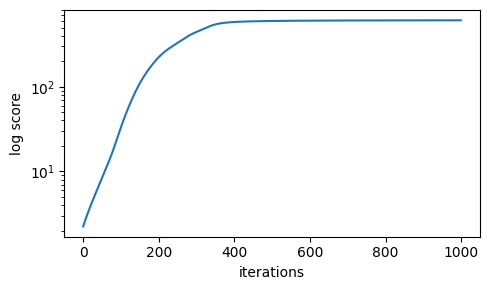

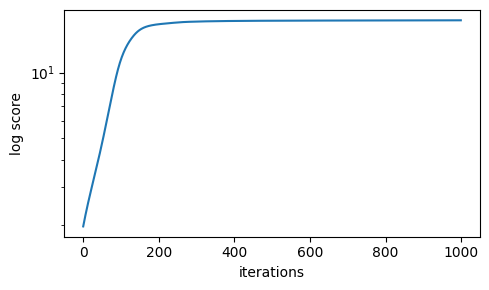

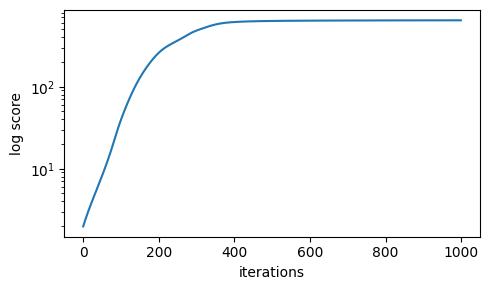

In [3]:
name = '3515_Lkb1_T1_Fam'
n_cells = 1000
gamma = 1
results_path = f'./results/gamma/{gamma}'

reproduce_gw_ew_results(name, 19442, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 82712, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 29873, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 52382, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 79815, n_cells, gamma=gamma)

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


epoch: 1000; score: 459.407292551187538; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 599.635115468152321; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 653.875173304489977; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.31it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 602.143962711781228; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 658.073286483369770; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.29it/s]


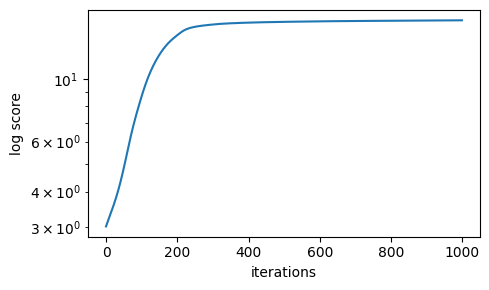

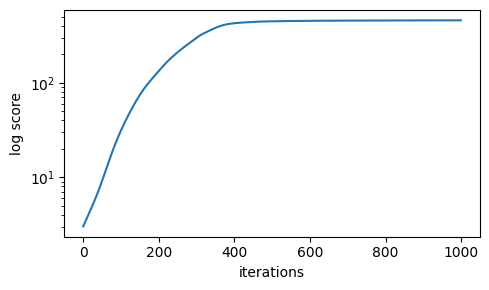

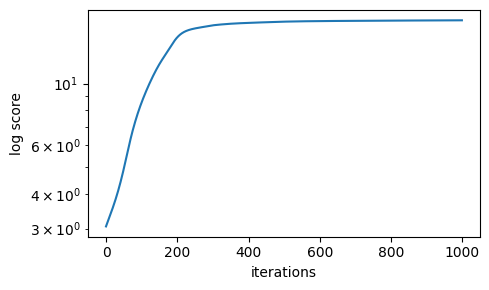

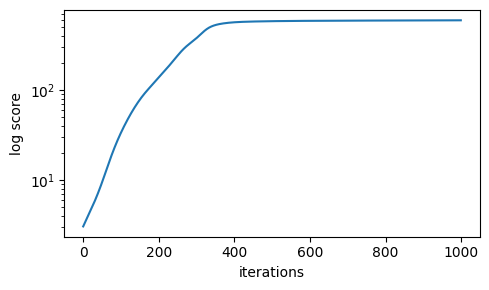

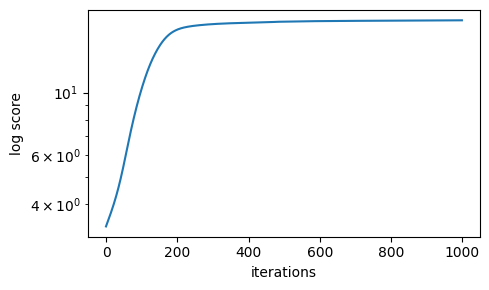

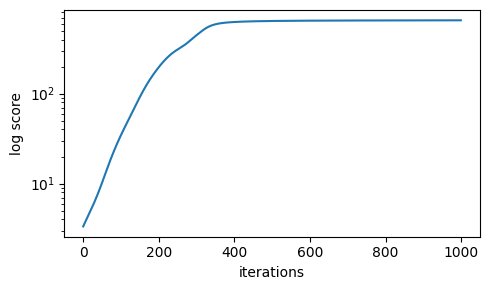

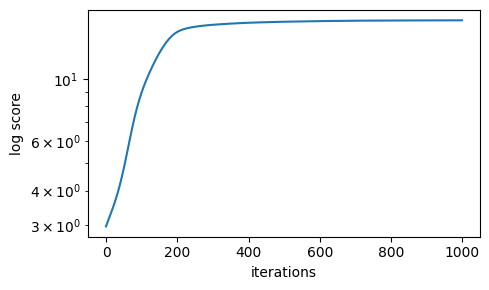

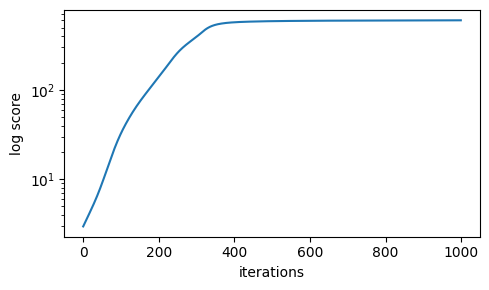

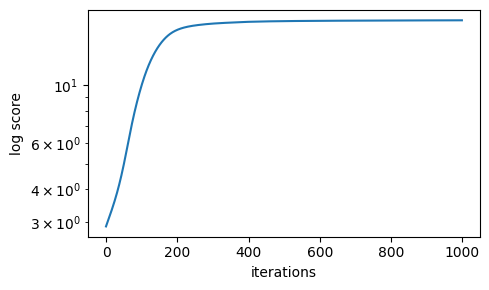

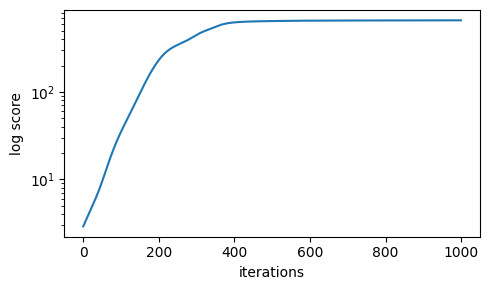

In [4]:
name = '3515_Lkb1_T1_Fam'
n_cells = 1000
gamma = 5
results_path = f'./results/gamma/{gamma}'

reproduce_gw_ew_results(name, 19442, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 82712, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 29873, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 52382, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 79815, n_cells, gamma=gamma)

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


epoch: 1000; score: 412.536454924810016; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 408.286859743089337; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 669.019022018066153; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 464.594833782683224; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 658.286353638478431; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.30it/s]


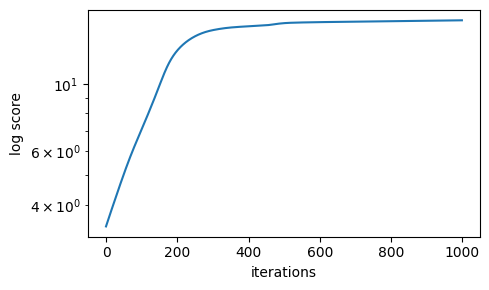

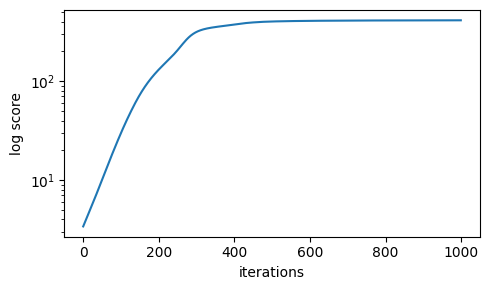

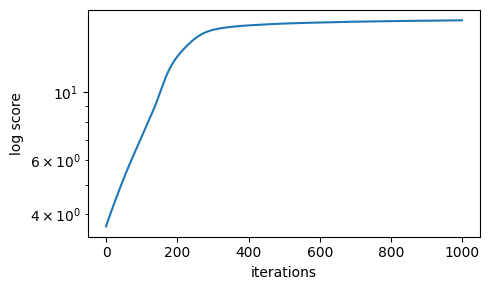

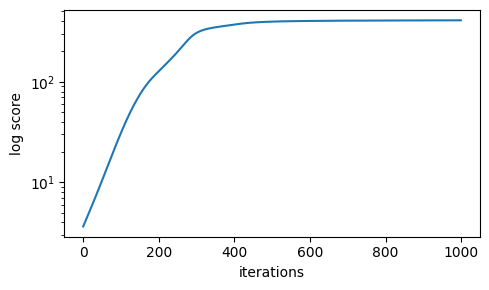

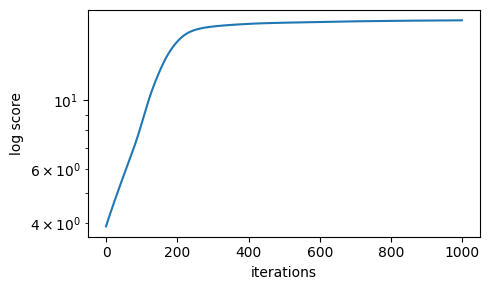

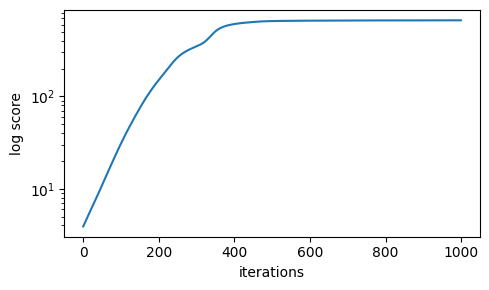

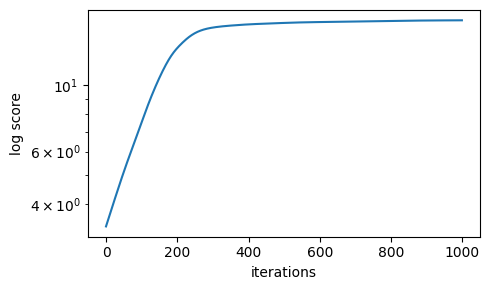

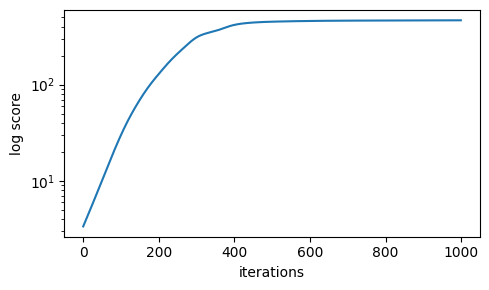

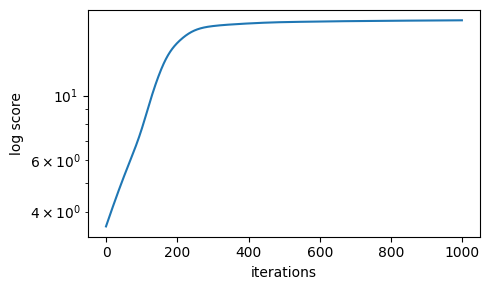

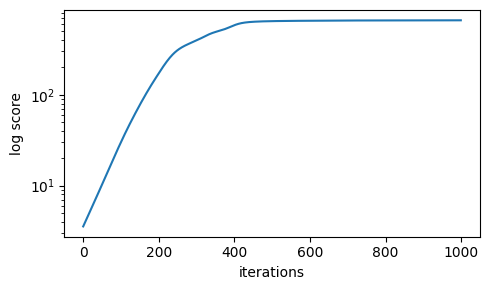

In [5]:
name = '3515_Lkb1_T1_Fam'
n_cells = 1000
gamma = 20
results_path = f'./results/gamma/{gamma}'

reproduce_gw_ew_results(name, 19442, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 82712, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 29873, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 52382, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 79815, n_cells, gamma=gamma)

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


epoch: 1000; score: 457.656432088189206; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 455.981005370020966; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.33it/s]


height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


epoch: 1000; score: 408.092076465737705; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 462.541394626546037; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.32it/s]


height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


epoch: 1000; score: 464.698671438778319; : 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1000/1000 [02:00<00:00,  8.31it/s]


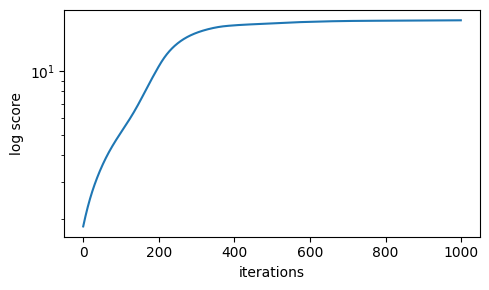

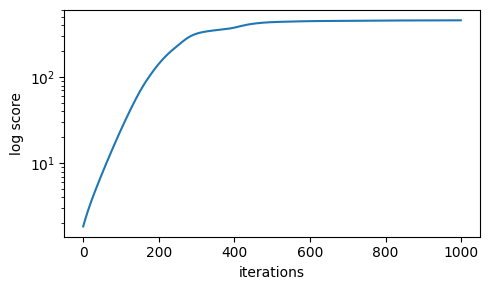

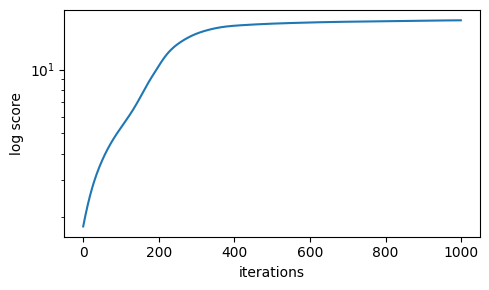

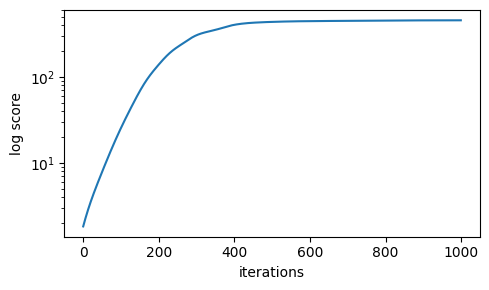

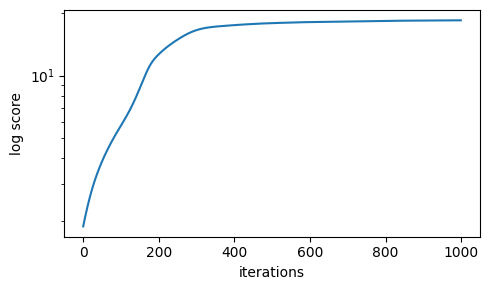

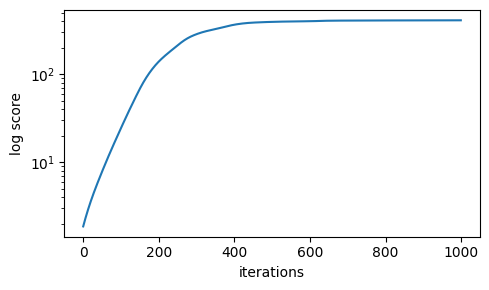

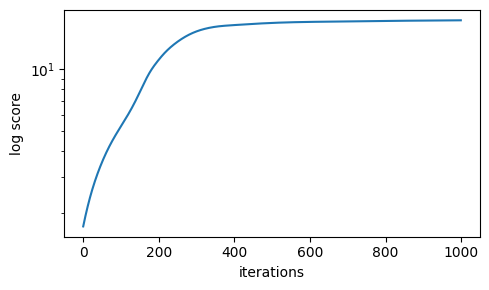

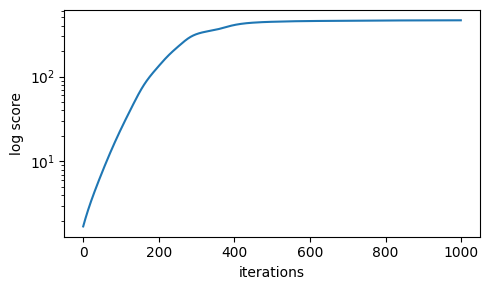

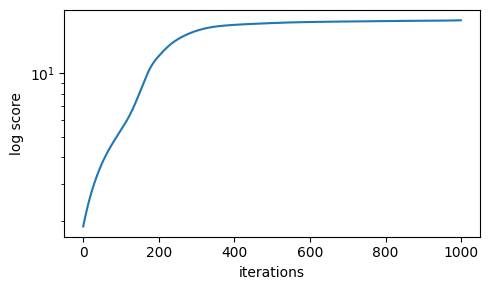

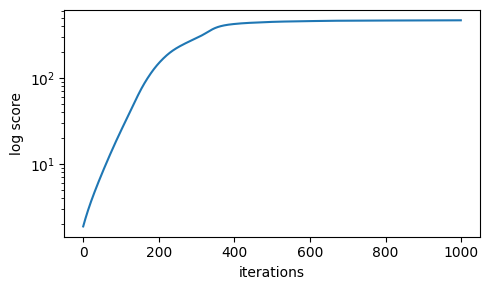

In [6]:
name = '3515_Lkb1_T1_Fam'
n_cells = 1000
gamma = 100
results_path = f'./results/gamma/{gamma}'

reproduce_gw_ew_results(name, 19442, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 82712, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 29873, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 52382, n_cells, gamma=gamma)
reproduce_gw_ew_results(name, 79815, n_cells, gamma=gamma)

## Select genes and GO-term analysis for gamma = 1

In [7]:
gamma = 1
results_path = f'./results/gamma/{gamma}'

### Seed 19442 (used in Fig. 3)

In [9]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 300) & (gene_rank_df['weight rank'] < 220), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,7,agree
Clu,1,-0.672344,0.672344,40,agree
Krt19,2,-0.539653,0.539653,9,agree
Sftpb,3,0.532347,0.532347,12,agree
Lyz2,4,0.678393,0.678393,5,agree
...,...,...,...,...,...
Dhrs11,712,-0.018061,0.018061,192,score <= 1.64
Dsn1,713,-0.083078,0.083078,442,score <= 1.64
Atxn7l2,714,-0.017457,0.017457,189,score <= 1.64
Pttg1,715,-0.013075,0.013075,282,score <= 1.64


score unsignificant at\n5% significance level    489
selected                                         181
not selected but\nscore significant               47
Name: color, dtype: int64


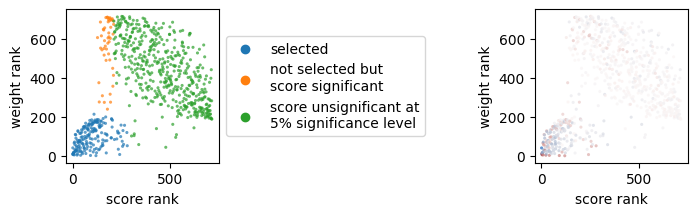

In [10]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [11]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000015,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000067,0.002002
2,Translation (GO:0006412),0.000548,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000548,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000639,0.014151
5,Gene Expression (GO:0010467),0.003437,0.012973
6,Tight Junction Assembly (GO:0120192),0.016251,0.211689
7,Apical Junction Assembly (GO:0043297),0.016251,0.217400
8,Negative Regulation Of Apoptotic Process (GO:0...,0.016251,0.114241
9,"mRNA Splicing, Via Spliceosome (GO:0000398)",0.016251,0.114241


### Seed 82712

In [12]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 300) & (gene_rank_df['weight rank'] < 220), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,6,agree
Krt19,1,-0.521188,0.521188,13,agree
Clu,2,-0.651429,0.651429,20,agree
Sftpb,3,0.538558,0.538558,11,agree
Lyz2,4,0.672166,0.672166,9,agree
...,...,...,...,...,...
Kbtbd4,712,-0.028890,0.028890,169,score <= 1.64
9530053A07Rik,713,0.022582,0.022582,203,score <= 1.64
Tekt5,714,-0.025042,0.025042,168,score <= 1.64
A930004D18Rik,715,-0.015447,0.015447,181,score <= 1.64


score unsignificant at\n5% significance level    510
selected                                         170
not selected but\nscore significant               37
Name: color, dtype: int64


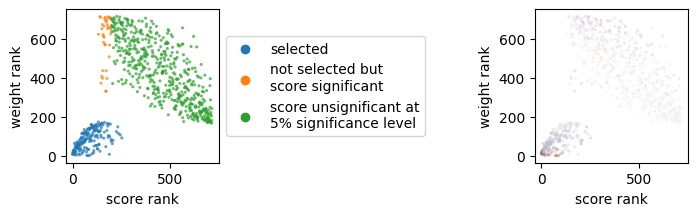

In [13]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [14]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000008,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000035,0.002002
2,Translation (GO:0006412),0.000316,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000316,0.014151
4,Gene Expression (GO:0010467),0.002234,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,0.011420,0.014151
6,Positive Regulation Of Cellular Respiration (G...,0.012236,0.269699
7,"mRNA Splicing, Via Spliceosome (GO:0000398)",0.012716,0.114241
8,mRNA Processing (GO:0006397),0.012716,0.269699
9,"RNA Splicing, Via Transesterification Reaction...",0.019318,0.308290


### Seed 29873

In [15]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 300) & (gene_rank_df['weight rank'] < 220), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,8,agree
Clu,1,-0.661422,0.661422,37,agree
Krt19,2,-0.551284,0.551284,12,agree
Sftpb,3,0.532827,0.532827,13,agree
Car2,4,-0.446704,0.446704,22,agree
...,...,...,...,...,...
Mdc1,712,-0.027598,0.027598,220,score <= 1.64
Mcl1,713,0.037991,0.037991,187,score <= 1.64
Il6,714,0.013758,0.013758,184,score <= 1.64
Chst9,715,-0.017068,0.017068,195,score <= 1.64


score unsignificant at\n5% significance level    494
selected                                         179
not selected but\nscore significant               44
Name: color, dtype: int64


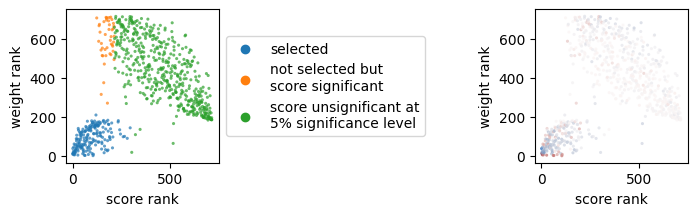

In [16]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [17]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000007,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000007,0.002002
2,Peptide Biosynthetic Process (GO:0043043),0.000064,0.014151
3,Translation (GO:0006412),0.000064,0.018059
4,Positive Regulation Of Peptidase Activity (GO:...,0.000601,0.014151
5,Gene Expression (GO:0010467),0.000601,0.012973
6,Regulation Of Translation (GO:0006417),0.002674,0.103212
7,"mRNA Splicing, Via Spliceosome (GO:0000398)",0.003410,0.114241
8,mRNA Processing (GO:0006397),0.003421,0.269699
9,"RNA Splicing, Via Transesterification Reaction...",0.004675,0.308290


### Seed 52382

In [18]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 250) & (gene_rank_df['weight rank'] < 220), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,7,agree
Clu,1,-0.648489,0.648489,29,agree
Krt19,2,-0.531977,0.531977,12,agree
Sftpb,3,0.505823,0.505823,13,agree
Lyz2,4,0.668199,0.668199,6,agree
...,...,...,...,...,...
Taco1os,712,-0.002069,0.002069,193,score <= 1.64
Wfs1,713,-0.002840,0.002840,184,score <= 1.64
Fam229b,714,-0.025951,0.025951,196,score <= 1.64
Rad54l,715,-0.037112,0.037112,189,score <= 1.64


score unsignificant at\n5% significance level    506
selected                                         175
not selected but\nscore significant               36
Name: color, dtype: int64


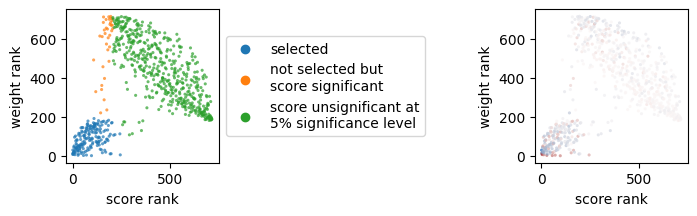

In [19]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [20]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000011,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000402,0.002002
2,Translation (GO:0006412),0.002919,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.003321,0.014151
4,Gene Expression (GO:0010467),0.012784,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,0.012784,0.014151
6,Protein Stabilization (GO:0050821),0.014870,0.232433
7,Tight Junction Assembly (GO:0120192),0.014870,0.211689
8,Apical Junction Assembly (GO:0043297),0.014870,0.217400
9,Positive Regulation Of Cellular Component Biog...,0.020676,0.424142


### Seed 79815

In [21]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 270) & (gene_rank_df['weight rank'] < 220), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,7,agree
Clu,1,-0.652748,0.652748,36,agree
Sftpb,2,0.553042,0.553042,12,agree
Krt19,3,-0.554289,0.554289,10,agree
Lyz2,4,0.700920,0.700920,6,agree
...,...,...,...,...,...
Rbm44,712,-0.022013,0.022013,216,score <= 1.64
Adcy9,713,0.032762,0.032762,200,score <= 1.64
Pced1a,714,-0.003941,0.003941,203,score <= 1.64
Champ1,715,-0.004314,0.004314,198,score <= 1.64


score unsignificant at\n5% significance level    497
selected                                         191
not selected but\nscore significant               29
Name: color, dtype: int64


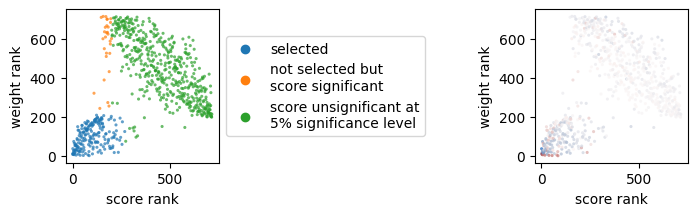

In [22]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [23]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000026,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000992,0.002002
2,Translation (GO:0006412),0.006940,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.006944,0.014151
4,Gene Expression (GO:0010467),0.007467,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,0.018676,0.014151
6,Tight Junction Assembly (GO:0120192),0.021261,0.211689
7,Apical Junction Assembly (GO:0043297),0.021261,0.217400
8,Positive Regulation Of Amide Metabolic Process...,0.021261,0.127855
9,Protein Stabilization (GO:0050821),0.021261,0.232433


## Select genes and GO-term analysis for gamma = 5

In [24]:
gamma = 5
results_path = f'./results/gamma/{gamma}'

### Seed 19442

In [25]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.672344,0.672344,1,agree
Sftpb,2,0.532347,0.532347,2,agree
Krt19,3,-0.539653,0.539653,4,agree
Lyz2,4,0.678393,0.678393,3,agree
...,...,...,...,...,...
Ncapg,712,-0.007941,0.007941,177,score <= 1.64
Dhrs11,713,-0.018061,0.018061,163,score <= 1.64
Myo5a,714,-0.030948,0.030948,195,score <= 1.64
Pttg1,715,-0.013075,0.013075,181,score <= 1.64


score unsignificant at\n5% significance level    478
selected                                         148
not selected but\nscore significant               91
Name: color, dtype: int64


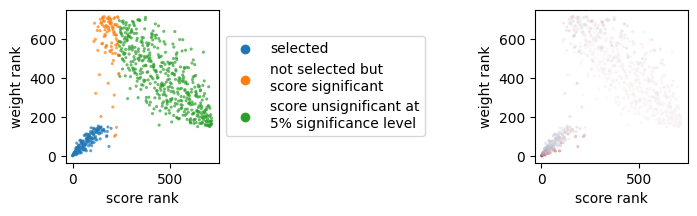

In [26]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [27]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000007,0.002002
2,Translation (GO:0006412),0.000068,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000081,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000223,0.014151
5,Gene Expression (GO:0010467),0.000409,0.012973
6,Negative Regulation Of Apoptotic Process (GO:0...,0.002326,0.114241
7,Tight Junction Assembly (GO:0120192),0.006203,0.211689
8,Apical Junction Assembly (GO:0043297),0.006203,0.217400
9,Epithelium Development (GO:0060429),0.017224,0.659353


### Seed 82712

In [28]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,2,agree
Clu,1,-0.651429,0.651429,5,agree
Sftpb,2,0.538558,0.538558,6,agree
Krt19,3,-0.521188,0.521188,4,agree
Lyz2,4,0.672166,0.672166,7,agree
...,...,...,...,...,...
Myo5a,712,-0.014488,0.014488,160,score <= 1.64
Arhgap40,713,-0.015369,0.015369,143,score <= 1.64
Tekt5,714,-0.025042,0.025042,216,score <= 1.64
Zfp386,715,0.002448,0.002448,227,score <= 1.64


score unsignificant at\n5% significance level    492
selected                                         137
not selected but\nscore significant               88
Name: color, dtype: int64


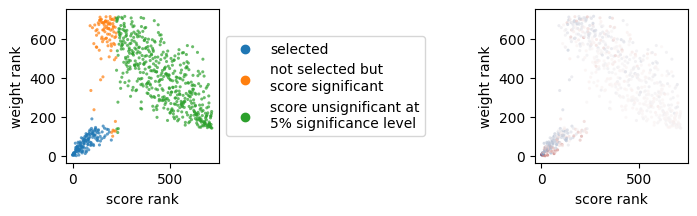

In [29]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [30]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),8.639068e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),2.881069e-05,0.002002
2,Translation (GO:0006412),2.285362e-04,0.018059
3,Peptide Biosynthetic Process (GO:0043043),3.831013e-04,0.014151
4,Gene Expression (GO:0010467),1.336215e-03,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,4.218701e-03,0.014151
6,Negative Regulation Of Apoptotic Process (GO:0...,4.223219e-03,0.114241
7,Positive Regulation Of Cellular Respiration (G...,4.835694e-03,0.269699
8,Calcium-Independent Cell-Cell Adhesion Via Pla...,3.317630e-02,0.447485
9,Tight Junction Assembly (GO:0120192),4.933271e-02,0.211689


### Seed 29873

In [31]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 210) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,5,agree
Clu,1,-0.661422,0.661422,13,agree
Sftpb,2,0.532827,0.532827,14,agree
Krt19,3,-0.551284,0.551284,6,agree
Car2,4,-0.446704,0.446704,15,agree
...,...,...,...,...,...
Mcl1,712,0.037991,0.037991,150,score <= 1.64
Il6,713,0.013758,0.013758,149,score <= 1.64
4732490B19Rik,714,-0.043440,0.043440,163,score <= 1.64
Nkx2-6,715,-0.022315,0.022315,169,score <= 1.64


score unsignificant at\n5% significance level    479
selected                                         147
not selected but\nscore significant               91
Name: color, dtype: int64


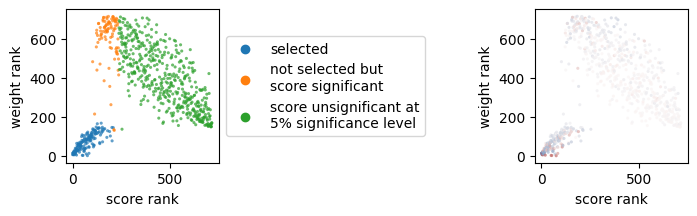

In [32]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [33]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),9.001554e-07,0.002002
1,Cytoplasmic Translation (GO:0002181),9.001554e-07,0.182657
2,Translation (GO:0006412),6.871710e-06,0.018059
3,Peptide Biosynthetic Process (GO:0043043),6.871710e-06,0.014151
4,Gene Expression (GO:0010467),9.037557e-06,0.012973
5,Protein Stabilization (GO:0050821),4.418116e-03,0.232433
6,Positive Regulation Of Peptidase Activity (GO:...,4.982886e-03,0.014151
7,Positive Regulation Of Amide Metabolic Process...,5.356824e-03,0.127855
8,Regulation Of Programmed Cell Death (GO:0043067),1.223853e-02,0.366372
9,Regulation Of Translation (GO:0006417),1.406141e-02,0.103212


### Seed 52382

In [34]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,4,agree
Clu,1,-0.648489,0.648489,6,agree
Krt19,2,-0.531977,0.531977,5,agree
Sftpb,3,0.505823,0.505823,8,agree
Lyz2,4,0.668199,0.668199,7,agree
...,...,...,...,...,...
Wfs1,712,-0.002840,0.002840,173,score <= 1.64
Rad54l,713,-0.037112,0.037112,224,score <= 1.64
Pard3b,714,-0.015227,0.015227,188,score <= 1.64
Ephb6,715,-0.044356,0.044356,183,score <= 1.64


score unsignificant at\n5% significance level    485
selected                                         150
not selected but\nscore significant               82
Name: color, dtype: int64


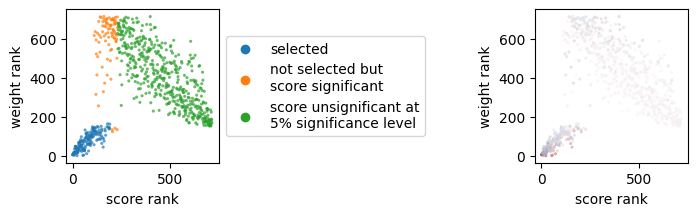

In [35]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [36]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000078,0.002002
2,Positive Regulation Of Peptidase Activity (GO:...,0.000394,0.014151
3,Translation (GO:0006412),0.000449,0.018059
4,Peptide Biosynthetic Process (GO:0043043),0.000693,0.014151
5,Gene Expression (GO:0010467),0.002814,0.012973
6,Protein Stabilization (GO:0050821),0.004529,0.232433
7,Tight Junction Assembly (GO:0120192),0.005904,0.211689
8,Positive Regulation Of Cellular Respiration (G...,0.005904,0.269699
9,Apical Junction Assembly (GO:0043297),0.005904,0.217400


### Seed 79815

In [37]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 300) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,6,agree
Clu,1,-0.652748,0.652748,12,agree
Sftpb,2,0.553042,0.553042,9,agree
Krt19,3,-0.554289,0.554289,7,agree
Lyz2,4,0.700920,0.700920,8,agree
...,...,...,...,...,...
Rnmtl1,712,-0.011296,0.011296,157,score <= 1.64
Tekt5,713,-0.042803,0.042803,158,score <= 1.64
1810014B01Rik,714,0.003474,0.003474,170,score <= 1.64
Adcy9,715,0.032762,0.032762,213,score <= 1.64


score unsignificant at\n5% significance level    481
selected                                         156
not selected but\nscore significant               80
Name: color, dtype: int64


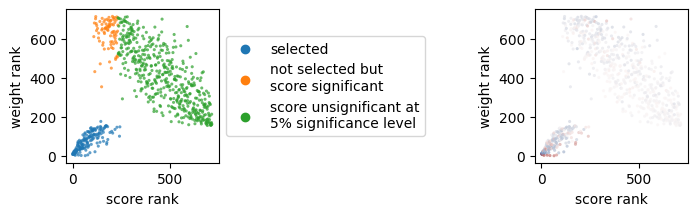

In [38]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [39]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000003,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000120,0.002002
2,Positive Regulation Of Peptidase Activity (GO:...,0.000493,0.014151
3,Translation (GO:0006412),0.000681,0.018059
4,Gene Expression (GO:0010467),0.000822,0.012973
5,Peptide Biosynthetic Process (GO:0043043),0.000822,0.014151
6,Protein Stabilization (GO:0050821),0.000932,0.232433
7,Positive Regulation Of Amide Metabolic Process...,0.007341,0.127855
8,Tight Junction Assembly (GO:0120192),0.007341,0.211689
9,Apical Junction Assembly (GO:0043297),0.007341,0.217400


## Select genes and GO-term analysis for gamma = 20

In [40]:
gamma = 20
results_path = f'./results/gamma/{gamma}'

### Seed 19442 (used in Fig. 3)

In [41]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 300) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.672344,0.672344,0,agree
Sftpb,2,0.532347,0.532347,2,agree
Krt19,3,-0.539653,0.539653,3,agree
Lyz2,4,0.678393,0.678393,5,agree
...,...,...,...,...,...
Dhrs11,712,-0.018061,0.018061,185,score <= 1.64
Wdr70,713,-0.050322,0.050322,184,score <= 1.64
Gm16863,714,-0.019560,0.019560,137,score <= 1.64
Kbtbd4,715,-0.027724,0.027724,138,score <= 1.64


score unsignificant at\n5% significance level    472
selected                                         139
not selected but\nscore significant              106
Name: color, dtype: int64


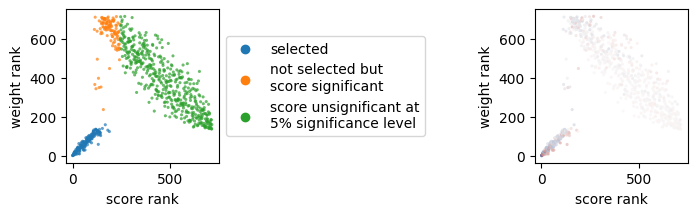

In [42]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [43]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),9.950914e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),3.087231e-06,0.002002
2,Translation (GO:0006412),3.159711e-05,0.018059
3,Peptide Biosynthetic Process (GO:0043043),4.198040e-05,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,1.520576e-04,0.014151
5,Gene Expression (GO:0010467),1.955716e-04,0.012973
6,Negative Regulation Of Apoptotic Process (GO:0...,1.049798e-03,0.114241
7,Tight Junction Assembly (GO:0120192),4.277647e-03,0.211689
8,Apical Junction Assembly (GO:0043297),4.277647e-03,0.217400
9,Calcium-Independent Cell-Cell Adhesion Via Pla...,2.801178e-02,0.447485


### Seed 82712

In [44]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.651429,0.651429,0,agree
Sftpb,2,0.538558,0.538558,2,agree
Krt19,3,-0.521188,0.521188,3,agree
Lyz2,4,0.672166,0.672166,5,agree
...,...,...,...,...,...
Stat2,712,0.037704,0.037704,139,score <= 1.64
Plpp6,713,0.003236,0.003236,136,score <= 1.64
Kbtbd4,714,-0.028890,0.028890,140,score <= 1.64
Ephb6,715,-0.019215,0.019215,150,score <= 1.64


score unsignificant at\n5% significance level    460
selected                                         132
not selected but\nscore significant              125
Name: color, dtype: int64


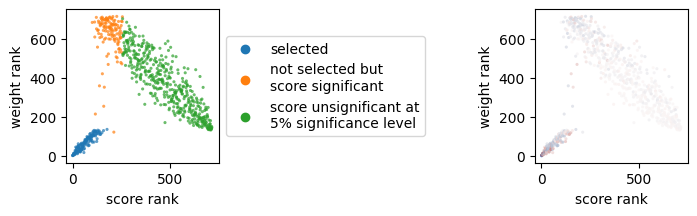

In [45]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [46]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),5.624980e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),1.839524e-05,0.002002
2,Translation (GO:0006412),1.476282e-04,0.018059
3,Gene Expression (GO:0010467),1.582747e-04,0.012973
4,Peptide Biosynthetic Process (GO:0043043),2.107185e-04,0.014151
5,Negative Regulation Of Apoptotic Process (GO:0...,2.932978e-03,0.114241
6,Positive Regulation Of Peptidase Activity (GO:...,2.932978e-03,0.014151
7,Positive Regulation Of Amide Metabolic Process...,2.791881e-02,0.127855
8,Calcium-Independent Cell-Cell Adhesion Via Pla...,2.791881e-02,0.447485
9,Tight Junction Assembly (GO:0120192),3.888150e-02,0.211689


### Seed 29873

In [48]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 250) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,4,agree
Clu,1,-0.661422,0.661422,8,agree
Sftpb,2,0.532827,0.532827,12,agree
Krt19,3,-0.551284,0.551284,5,agree
Car2,4,-0.446704,0.446704,13,agree
...,...,...,...,...,...
Hey1,712,0.010249,0.010249,158,score <= 1.64
Nkx2-6,713,-0.022315,0.022315,191,score <= 1.64
2700049A03Rik,714,-0.031065,0.031065,260,score <= 1.64
Il6,715,0.013758,0.013758,145,score <= 1.64


score unsignificant at\n5% significance level    447
selected                                         146
not selected but\nscore significant              124
Name: color, dtype: int64


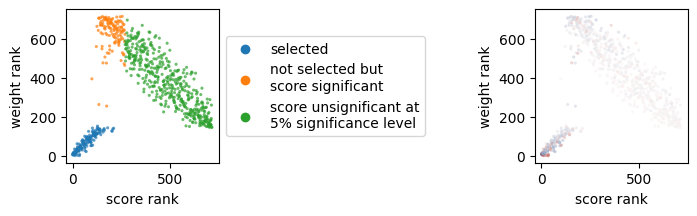

In [49]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [50]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),8.292064e-07,0.002002
1,Cytoplasmic Translation (GO:0002181),8.292064e-07,0.182657
2,Translation (GO:0006412),6.302585e-06,0.018059
3,Peptide Biosynthetic Process (GO:0043043),6.302585e-06,0.014151
4,Gene Expression (GO:0010467),8.158759e-06,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,1.664992e-04,0.014151
6,Positive Regulation Of Amide Metabolic Process...,5.801831e-03,0.127855
7,Protein Stabilization (GO:0050821),2.019420e-02,0.232433
8,Negative Regulation Of Apoptotic Process (GO:0...,2.705252e-02,0.114241
9,Positive Regulation Of Macromolecule Biosynthe...,2.849492e-02,0.366372


### Seed 52382

In [51]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.648489,0.648489,1,agree
Sftpb,2,0.505823,0.505823,3,agree
Krt19,3,-0.531977,0.531977,2,agree
Lyz2,4,0.668199,0.668199,4,agree
...,...,...,...,...,...
Gm14418,712,-0.024923,0.024923,158,score <= 1.64
Armc5,713,-0.038982,0.038982,226,score <= 1.64
Ephb6,714,-0.044356,0.044356,186,score <= 1.64
M1ap,715,-0.036859,0.036859,140,score <= 1.64


score unsignificant at\n5% significance level    464
selected                                         140
not selected but\nscore significant              113
Name: color, dtype: int64


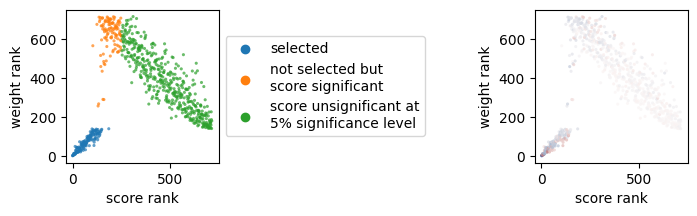

In [52]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [53]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000001,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000003,0.002002
2,Translation (GO:0006412),0.000035,0.018059
3,Peptide Biosynthetic Process (GO:0043043),0.000046,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,0.000162,0.014151
5,Gene Expression (GO:0010467),0.000217,0.012973
6,Tight Junction Assembly (GO:0120192),0.005112,0.211689
7,Apical Junction Assembly (GO:0043297),0.005112,0.217400
8,Negative Regulation Of Apoptotic Process (GO:0...,0.018169,0.114241
9,Calcium-Independent Cell-Cell Adhesion Via Pla...,0.029717,0.447485


### Seed 79815

In [54]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,5,agree
Clu,1,-0.652748,0.652748,9,agree
Sftpb,2,0.553042,0.553042,8,agree
Krt19,3,-0.554289,0.554289,6,agree
Lyz2,4,0.700920,0.700920,7,agree
...,...,...,...,...,...
Rnmtl1,712,-0.011296,0.011296,173,score <= 1.64
1810014B01Rik,713,0.003474,0.003474,174,score <= 1.64
Arhgap40,714,-0.007445,0.007445,155,score <= 1.64
Gm26609,715,-0.007169,0.007169,150,score <= 1.64


score unsignificant at\n5% significance level    465
selected                                         150
not selected but\nscore significant              102
Name: color, dtype: int64


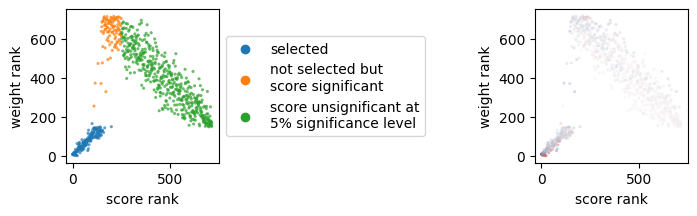

In [55]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [56]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),0.000002,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),0.000079,0.002002
2,Positive Regulation Of Peptidase Activity (GO:...,0.000401,0.014151
3,Translation (GO:0006412),0.000458,0.018059
4,Peptide Biosynthetic Process (GO:0043043),0.000706,0.014151
5,Gene Expression (GO:0010467),0.002866,0.012973
6,Protein Stabilization (GO:0050821),0.004613,0.232433
7,Positive Regulation Of Amide Metabolic Process...,0.006014,0.127855
8,Tight Junction Assembly (GO:0120192),0.006014,0.211689
9,Apical Junction Assembly (GO:0043297),0.006014,0.217400


## Select genes and GO-term analysis for gamma = 100

In [57]:
gamma = 100
results_path = f'./results/gamma/{gamma}'

### Seed 19442

In [58]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.672344,0.672344,1,agree
Sftpb,2,0.532347,0.532347,2,agree
Lyz2,3,0.678393,0.678393,4,agree
Krt19,4,-0.539653,0.539653,3,agree
...,...,...,...,...,...
Ncapg,712,-0.007941,0.007941,151,score <= 1.64
Ly75,713,-0.008467,0.008467,140,score <= 1.64
1810014B01Rik,714,-0.016915,0.016915,139,score <= 1.64
Kbtbd4,715,-0.027724,0.027724,131,score <= 1.64


score unsignificant at\n5% significance level    466
selected                                         130
not selected but\nscore significant              121
Name: color, dtype: int64


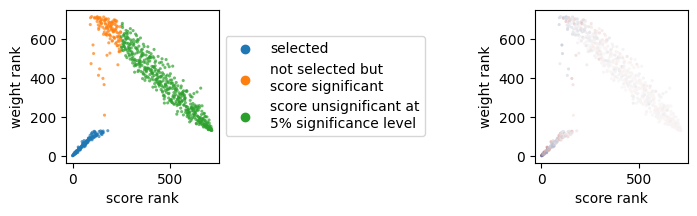

In [59]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [60]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),4.920988e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),1.370420e-06,0.002002
2,Translation (GO:0006412),1.432636e-05,0.018059
3,Peptide Biosynthetic Process (GO:0043043),2.131967e-05,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,9.098192e-05,0.014151
5,Gene Expression (GO:0010467),9.098192e-05,0.012973
6,Negative Regulation Of Apoptotic Process (GO:0...,2.298727e-03,0.114241
7,Tight Junction Assembly (GO:0120192),3.041858e-03,0.211689
8,Calcium-Independent Cell-Cell Adhesion Via Pla...,2.482312e-02,0.447485
9,Bicellular Tight Junction Assembly (GO:0070830),2.482312e-02,0.325520


### Seed 82712

In [61]:
name = '3515_Lkb1_T1_Fam'
seed = 82712
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.651429,0.651429,1,agree
Sftpb,2,0.538558,0.538558,2,agree
Lyz2,3,0.672166,0.672166,4,agree
Krt19,4,-0.521188,0.521188,3,agree
...,...,...,...,...,...
Kbtbd4,712,-0.028890,0.028890,137,score <= 1.64
Fam195b,713,0.043691,0.043691,156,score <= 1.64
Dph7,714,0.012298,0.012298,145,score <= 1.64
Gm26782,715,0.015467,0.015467,136,score <= 1.64


score unsignificant at\n5% significance level    456
selected                                         137
not selected but\nscore significant              124
Name: color, dtype: int64


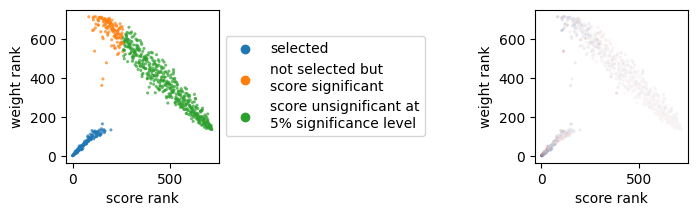

In [62]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [63]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),4.160907e-07,0.002002
1,Cytoplasmic Translation (GO:0002181),4.160907e-07,0.182657
2,Translation (GO:0006412),2.791698e-06,0.018059
3,Peptide Biosynthetic Process (GO:0043043),3.033365e-06,0.014151
4,Gene Expression (GO:0010467),2.668364e-05,0.012973
5,Positive Regulation Of Peptidase Activity (GO:...,1.137039e-04,0.014151
6,Negative Regulation Of Apoptotic Process (GO:0...,3.949438e-03,0.114241
7,Tight Junction Assembly (GO:0120192),3.949438e-03,0.211689
8,Calcium-Independent Cell-Cell Adhesion Via Pla...,2.781256e-02,0.447485
9,Positive Regulation Of Amide Metabolic Process...,2.781256e-02,0.127855


### Seed 29873

In [64]:
name = '3515_Lkb1_T1_Fam'
seed = 29873
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 210) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 20.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,1,agree
Clu,1,-0.661422,0.661422,2,agree
Sftpb,2,0.532827,0.532827,3,agree
Krt19,3,-0.551284,0.551284,0,agree
Car2,4,-0.446704,0.446704,4,agree
...,...,...,...,...,...
Pdp2,712,0.016011,0.016011,144,score <= 1.64
Nfatc4,713,-0.046748,0.046748,152,score <= 1.64
Atxn7l2,714,0.008281,0.008281,142,score <= 1.64
Champ1,715,0.004733,0.004733,150,score <= 1.64


score unsignificant at\n5% significance level    425
not selected but\nscore significant              151
selected                                         141
Name: color, dtype: int64


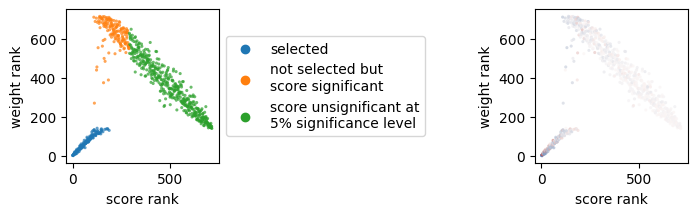

In [65]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [66]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Macromolecule Biosynthetic Process (GO:0009059),5.928689e-07,0.002002
1,Cytoplasmic Translation (GO:0002181),5.928689e-07,0.182657
2,Translation (GO:0006412),3.845610e-06,0.018059
3,Peptide Biosynthetic Process (GO:0043043),3.845610e-06,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,3.845610e-06,0.014151
5,Gene Expression (GO:0010467),4.379363e-06,0.012973
6,Positive Regulation Of Amide Metabolic Process...,3.651407e-04,0.127855
7,Tight Junction Assembly (GO:0120192),4.270052e-03,0.211689
8,Negative Regulation Of Apoptotic Process (GO:0...,4.270052e-03,0.114241
9,Apical Junction Assembly (GO:0043297),4.270052e-03,0.217400


### Seed 52382

In [67]:
name = '3515_Lkb1_T1_Fam'
seed = 52382
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.648489,0.648489,1,agree
Lyz2,2,0.668199,0.668199,4,agree
Sftpb,3,0.505823,0.505823,3,agree
Krt19,4,-0.531977,0.531977,2,agree
...,...,...,...,...,...
Dph7,712,0.013090,0.013090,150,score <= 1.64
Gm26609,713,-0.018706,0.018706,140,score <= 1.64
Cc2d2a,714,-0.038543,0.038543,146,score <= 1.64
Tdrkh,715,0.018420,0.018420,134,score <= 1.64


score unsignificant at\n5% significance level    453
selected                                         136
not selected but\nscore significant              128
Name: color, dtype: int64


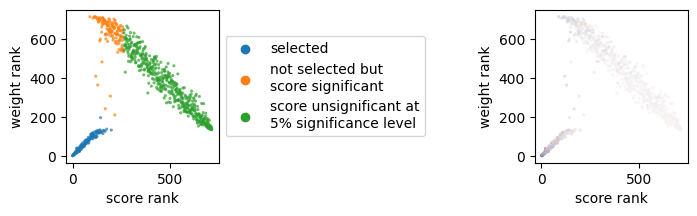

In [68]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [69]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),7.970735e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),2.388218e-06,0.002002
2,Translation (GO:0006412),2.461610e-05,0.018059
3,Peptide Biosynthetic Process (GO:0043043),3.392575e-05,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,1.354333e-04,0.014151
5,Gene Expression (GO:0010467),1.536726e-04,0.012973
6,Apical Junction Assembly (GO:0043297),4.916262e-03,0.217400
7,Negative Regulation Of Apoptotic Process (GO:0...,1.499717e-02,0.114241
8,Bone Development (GO:0060348),2.552000e-02,0.424142
9,Calcium-Independent Cell-Cell Adhesion Via Pla...,2.552000e-02,0.447485


### Seed 79815

In [70]:
name = '3515_Lkb1_T1_Fam'
seed = 79815
n_cells = 1000

tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

# Rank comparison to select genes
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values

compare_gene = use_genes[0]
gene_rank_df = pd.DataFrame(index=use_genes)
gene_rank_df['score rank'] = np.argsort(np.argsort(-scores.loc[use_genes]['score']))
gene_rank_df[f'{compare_gene} corr'] = norm_expression[use_genes].corrwith(norm_expression[compare_gene])
gene_rank_df.loc[compare_gene, f'{compare_gene} corr'] = np.nan
gene_rank_df[f'{compare_gene} abs corr'] = gene_rank_df[f'{compare_gene} corr'].abs()
gene_rank_df['weight rank'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df['color'] = 'score <= 1.64'
gene_rank_df.loc[scores.loc[use_genes]['score'] > 1.64, 'color'] = 'score > 1.64'
gene_rank_df.loc[(gene_rank_df['score rank'] < 200) & (gene_rank_df['weight rank'] < 200), 'color'] = 'agree'
gene_rank_df

height before: 22.0
leaves before: 1878
height after: 21.0
leaves after: 1000


,score rank,Sftpc corr,Sftpc abs corr,weight rank,color
Sftpc,0,NaN,NaN,0,agree
Clu,1,-0.652748,0.652748,2,agree
Sftpb,2,0.553042,0.553042,3,agree
Lyz2,3,0.700920,0.700920,4,agree
Krt19,4,-0.554289,0.554289,1,agree
...,...,...,...,...,...
Zc3h3,712,0.036151,0.036151,172,score <= 1.64
Dync2h1,713,-0.007016,0.007016,140,score <= 1.64
Arhgap40,714,-0.007445,0.007445,153,score <= 1.64
Tada2b,715,0.011931,0.011931,137,score <= 1.64


score unsignificant at\n5% significance level    448
selected                                         138
not selected but\nscore significant              131
Name: color, dtype: int64


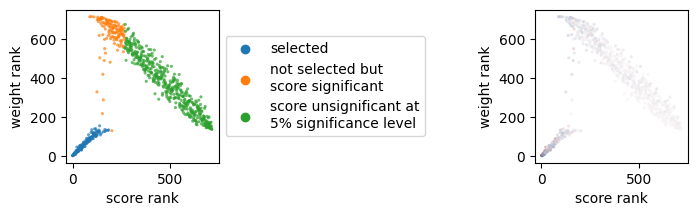

In [71]:
import seaborn as sns

gene_rank_df['color'] = gene_rank_df['color'].replace({'agree':'selected',
                                                           'score <= 1.64':'score unsignificant at\n5% significance level',
                                                           'score > 1.64':'not selected but\nscore significant'})
gene_rank_df[gene_rank_df['color'] == 'selected'].to_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', columns=[], header=False)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(7, 3))
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue='color', alpha=0.7, ax=ax1)
sns.move_legend(
    ax1, "center left",
    bbox_to_anchor=(1.0, 0.5), ncol=1, title=None,
)
sns.scatterplot(gene_rank_df, x='score rank', y='weight rank', s=5, edgecolor="none", hue=f'{compare_gene} corr', palette='vlag', alpha=0.7, ax=ax2)
sm = plt.cm.ScalarMappable(cmap='vlag', norm=plt.Normalize(gene_rank_df[f'{compare_gene} corr'].min(),
                                                           gene_rank_df[f'{compare_gene} corr'].max()))
print(gene_rank_df['color'].value_counts())
ax2.get_legend().remove()
ax1.set_aspect(1)
ax2.set_aspect(1)
fig.tight_layout(w_pad=5)

In [72]:
# match with GO terms from GO_Biological_Process_2023
all_genes = gene_rank_df.index.values.tolist()
selected = gene_rank_df[gene_rank_df['color'] == 'selected'].index.values.tolist()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
time.sleep(1)  # gseapy.enrichr doesn't allow fast successive API calls
enr = gseapy.enrichr(gene_list=selected, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_selected = set(enr.results[enr.results['Adjusted P-value'] <= 0.05]['Term'].values)

df = enr.results[enr.results['Adjusted P-value'] <= 0.05][['Term', 'Adjusted P-value']].copy()
df['Adjusted P-value using all genes'] = enr_all.results.set_index('Term').loc[df['Term'], 'Adjusted P-value'].values
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub_{seed}.csv', index=False)
df

,Term,Adjusted P-value,Adjusted P-value using all genes
0,Cytoplasmic Translation (GO:0002181),9.505958e-07,0.182657
1,Macromolecule Biosynthetic Process (GO:0009059),2.915494e-06,0.002002
2,Translation (GO:0006412),2.990975e-05,0.018059
3,Peptide Biosynthetic Process (GO:0043043),4.022184e-05,0.014151
4,Positive Regulation Of Peptidase Activity (GO:...,1.504439e-04,0.014151
5,Gene Expression (GO:0010467),1.856567e-04,0.012973
6,Negative Regulation Of Apoptotic Process (GO:0...,9.895197e-04,0.114241
7,Positive Regulation Of Amide Metabolic Process...,3.679759e-03,0.127855
8,Tight Junction Assembly (GO:0120192),3.813612e-03,0.211689
9,Apical Junction Assembly (GO:0043297),3.813612e-03,0.217400


## Tree plots and GO-terms

### Gamma = 1

In [116]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
gamma = 1
results_path = f'./results/gamma/{gamma}'
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


In [117]:
additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [118]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [119]:
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df

array(['Macromolecule Biosynthetic Process (GO:0009059)',
       'Gene Expression (GO:0010467)',
       'Peptide Biosynthetic Process (GO:0043043)',
       'Positive Regulation Of Peptidase Activity (GO:0010952)',
       'RNA Processing (GO:0006396)', 'Translation (GO:0006412)',
       'Growth Hormone Receptor Signaling Pathway Via JAK-STAT (GO:0060397)',
       'Formation Of Cytoplasmic Translation Initiation Complex (GO:0001732)'],
      dtype=object)


,Adjusted P-value using selected genes (82712),Adjusted P-value using selected genes (29873),Adjusted P-value using selected genes (52382),Adjusted P-value using selected genes (19442),Adjusted P-value using selected genes (79815),Avg. adjusted P-value using selected genes,Adjusted P-value using all expressed genes
Term,,,,,,,
Cytoplasmic Translation (GO:0002181),0.000008,0.000007,0.000011,0.000015,0.000026,0.000013,0.182657
Macromolecule Biosynthetic Process (GO:0009059),0.000035,0.000007,0.000402,0.000067,0.000992,0.000301,0.002002
Translation (GO:0006412),0.000316,0.000064,0.002919,0.000548,0.006940,0.002157,0.018059
Peptide Biosynthetic Process (GO:0043043),0.000316,0.000064,0.003321,0.000548,0.006944,0.002238,0.014151
Gene Expression (GO:0010467),0.002234,0.000601,0.012784,0.003437,0.007467,0.005304,0.012973
...,...,...,...,...,...,...,...
Positive Regulation Of Cell Differentiation (GO:0045597),0.915935,0.742521,0.921298,0.928901,0.936565,0.889044,0.864839
Protein Ubiquitination (GO:0016567),0.977168,0.980644,0.901135,0.981482,0.801256,0.928337,0.894410
Organelle Organization (GO:0006996),0.975207,0.979097,0.976374,0.980132,0.913306,0.964823,0.788148


/tmp/ipykernel_4013830/2630826475.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[13] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
/tmp/ipykernel_4013830/2630826475.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[10] = 'RNA Splicing, Via Transesterification Reactions With ... (GO:0000377)'


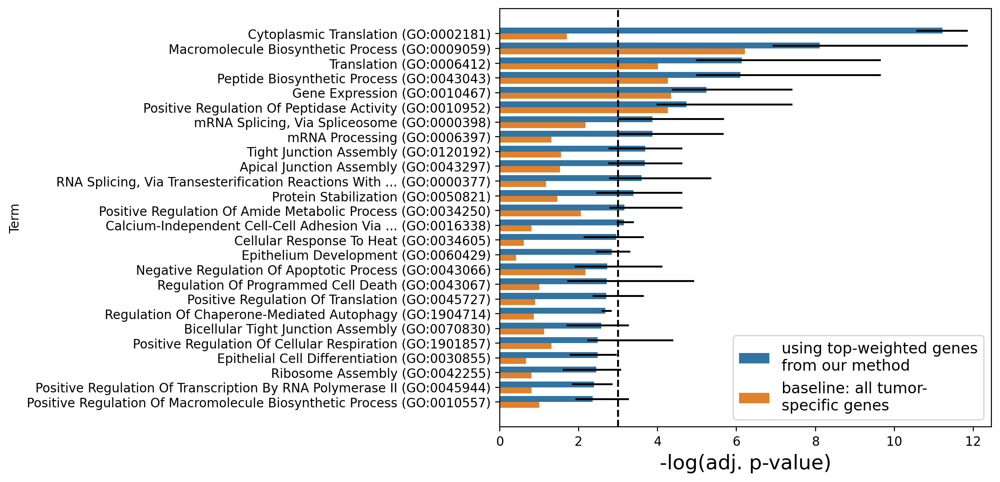

In [122]:
df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
assert df['Term'].loc[13] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[13] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
assert df['Term'].loc[10] == 'RNA Splicing, Via Transesterification Reactions With Bulged Adenosine As Nucleophile (GO:0000377)'
df['Term'].loc[10] = 'RNA Splicing, Via Transesterification Reactions With ... (GO:0000377)'
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df.apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
mdf.loc[0:len(df)-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'low'] -= (-df[df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:len(df)-1, 'up'] += (-df[df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all tumor-\nspecific genes'})

fig, ax = plt.subplots(dpi=200, figsize=(7, 6))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')

### Gamma = 5

In [107]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
gamma = 5
results_path = f'./results/gamma/{gamma}'
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


In [108]:
additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [110]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [111]:
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df

array(['Macromolecule Biosynthetic Process (GO:0009059)',
       'Gene Expression (GO:0010467)',
       'Peptide Biosynthetic Process (GO:0043043)',
       'Positive Regulation Of Peptidase Activity (GO:0010952)',
       'RNA Processing (GO:0006396)', 'Translation (GO:0006412)',
       'Growth Hormone Receptor Signaling Pathway Via JAK-STAT (GO:0060397)',
       'Formation Of Cytoplasmic Translation Initiation Complex (GO:0001732)'],
      dtype=object)


,Adjusted P-value using selected genes (82712),Adjusted P-value using selected genes (29873),Adjusted P-value using selected genes (52382),Adjusted P-value using selected genes (19442),Adjusted P-value using selected genes (79815),Avg. adjusted P-value using selected genes,Adjusted P-value using all expressed genes
Term,,,,,,,
Cytoplasmic Translation (GO:0002181),8.639068e-07,9.001554e-07,0.000002,0.000002,0.000003,0.000002,0.182657
Macromolecule Biosynthetic Process (GO:0009059),2.881069e-05,9.001554e-07,0.000078,0.000007,0.000120,0.000047,0.002002
Translation (GO:0006412),2.285362e-04,6.871710e-06,0.000449,0.000068,0.000681,0.000287,0.018059
Peptide Biosynthetic Process (GO:0043043),3.831013e-04,6.871710e-06,0.000693,0.000081,0.000822,0.000397,0.014151
Gene Expression (GO:0010467),1.336215e-03,9.037557e-06,0.002814,0.000409,0.000822,0.001078,0.012973
...,...,...,...,...,...,...,...
Positive Regulation Of Cell Differentiation (GO:0045597),8.630787e-01,8.818380e-01,0.886936,0.884261,0.895743,0.882371,0.864839
Protein Modification Process (GO:0036211),8.728473e-01,9.014641e-01,0.908849,0.903917,0.921392,0.901694,0.794532
Phosphorylation (GO:0016310),8.048791e-01,9.600715e-01,0.962645,0.960931,0.967318,0.931169,0.716849


/tmp/ipykernel_4013830/2171891641.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'


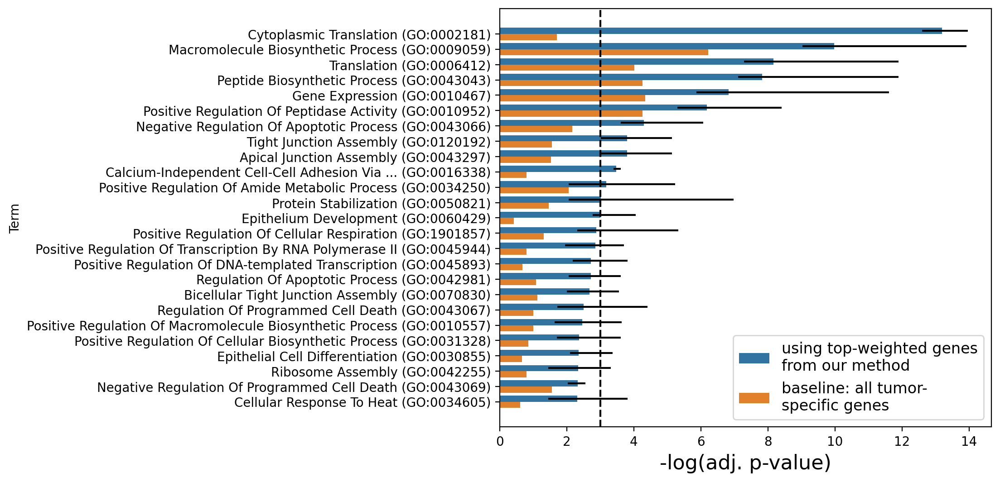

In [115]:
df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
assert df['Term'].loc[9] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df.apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
mdf.loc[0:len(df)-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'low'] -= (-df[df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:len(df)-1, 'up'] += (-df[df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all tumor-\nspecific genes'})

fig, ax = plt.subplots(dpi=200, figsize=(7, 6))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')

### Gamma = 20

In [98]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
gamma = 20
results_path = f'./results/gamma/{gamma}'
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


In [99]:
additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [100]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [101]:
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df

array(['Macromolecule Biosynthetic Process (GO:0009059)',
       'Gene Expression (GO:0010467)',
       'Peptide Biosynthetic Process (GO:0043043)',
       'Positive Regulation Of Peptidase Activity (GO:0010952)',
       'RNA Processing (GO:0006396)', 'Translation (GO:0006412)',
       'Growth Hormone Receptor Signaling Pathway Via JAK-STAT (GO:0060397)',
       'Formation Of Cytoplasmic Translation Initiation Complex (GO:0001732)'],
      dtype=object)


,Adjusted P-value using selected genes (82712),Adjusted P-value using selected genes (29873),Adjusted P-value using selected genes (52382),Adjusted P-value using selected genes (19442),Adjusted P-value using selected genes (79815),Avg. adjusted P-value using selected genes,Adjusted P-value using all expressed genes
Term,,,,,,,
Cytoplasmic Translation (GO:0002181),5.624980e-07,8.292064e-07,0.000001,9.950914e-07,0.000002,0.000001,0.182657
Macromolecule Biosynthetic Process (GO:0009059),1.839524e-05,8.292064e-07,0.000003,3.087231e-06,0.000079,0.000021,0.002002
Translation (GO:0006412),1.476282e-04,6.302585e-06,0.000035,3.159711e-05,0.000458,0.000136,0.018059
Peptide Biosynthetic Process (GO:0043043),2.107185e-04,6.302585e-06,0.000046,4.198040e-05,0.000706,0.000202,0.014151
Gene Expression (GO:0010467),1.582747e-04,8.158759e-06,0.000217,1.955716e-04,0.002866,0.000689,0.012973
...,...,...,...,...,...,...,...
Positive Regulation Of Cell Differentiation (GO:0045597),8.528064e-01,8.801259e-01,0.869748,8.687356e-01,0.886864,0.871656,0.864839
Protein Modification Process (GO:0036211),9.917188e-01,9.680808e-01,0.961664,8.799530e-01,0.908790,0.942041,0.794532
Organelle Organization (GO:0006996),9.418584e-01,9.573550e-01,0.951184,9.492472e-01,0.960088,0.951947,0.788148


/tmp/ipykernel_4013830/804920066.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[10] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'


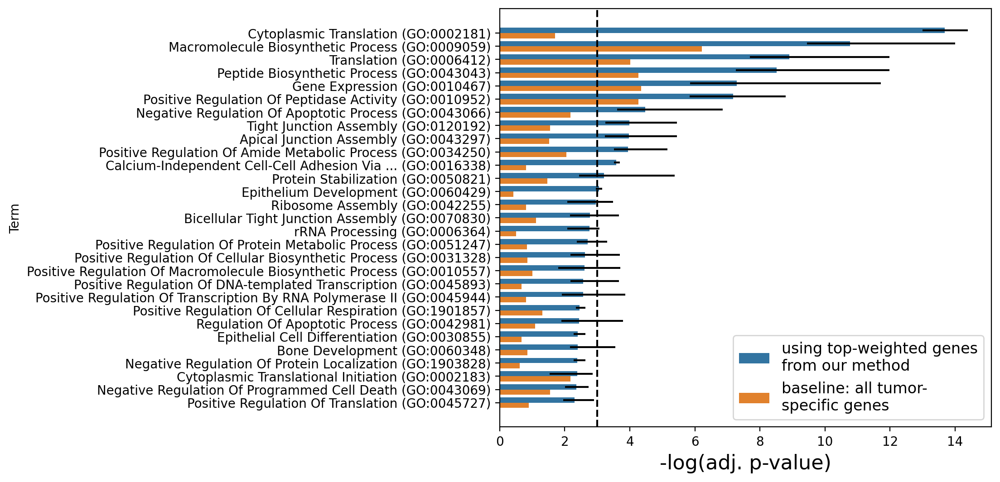

In [105]:
df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
assert df['Term'].loc[10] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[10] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df.apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
mdf.loc[0:len(df)-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'low'] -= (-df[df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:len(df)-1, 'up'] += (-df[df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all tumor-\nspecific genes'})

fig, ax = plt.subplots(dpi=200, figsize=(7, 6))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')

### Gamma = 100

In [90]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
gamma = 100
results_path = f'./results/gamma/{gamma}'
tree_path, expression, cell_meta, labels_in_order = load_data(name, seed, n_cells)
norm_expression = ((expression - expression.mean(axis=0))/expression.std(axis=0))

gene_scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
scores_subtree = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_subtree_sub_{seed}.csv', index_col='Unnamed: 0')
scores_remaining = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_remaining_sub_{seed}.csv', index_col='Unnamed: 0')
ewg_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ewg_sub_{seed}.csv', index_col='Unnamed: 0')
gw_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')


show_genes = list(gw_df.sort_values('weight', ascending=False).index[:20])

etree = augment_tree_with_weights(tree_path, 1 + 0 * ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ewg_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

node_labels = np.concatenate([norm_expression.index, scores_subtree.index])

height before: 22.0
leaves before: 1878
height after: 22.0
leaves after: 1000


In [91]:
additional_color_domain = [
    '3515_Lkb1_T1',
    '3515_Lkb1_K2',
    '3515_Lkb1_K3',
    '3515_Lkb1_L2',
    '3515_Lkb1_N1',
    '3515_Lkb1_L1',
    '3515_Lkb1_K1',
]

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [92]:
ew_df = pd.read_csv(f'{results_path}/scores/tumor/{name}_ew_sub_{seed}.csv', index_col='Unnamed: 0')

etree = augment_tree_with_weights(tree_path, 1 + 0 * ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_a, edge_data_a = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_a.loc[0, 'cell_label'] = 'N0000'

etree = augment_tree_with_weights(tree_path, ew_df['weight'], quoted_node_names=True)
etree.write(outfile=f'{data_path}/temp.nwk', format=1)
node_data_b, edge_data_b = get_node_and_edge_data(f'{data_path}/temp.nwk')
node_data_b.loc[0, 'cell_label'] = 'N0000'

nodes = node_data_a.merge(node_data_b, how='outer', left_on=['cell_label', 'is_leaf'],
                          right_on=['cell_label', 'is_leaf'], suffixes=('_a', '_b'))
edges = edge_data_a.merge(edge_data_b, how='outer', left_index=True, right_index=True, suffixes=('_a', '_b'))

double_tree_plot(nodes, edges, cell_labels=labels_in_order,
                 colors=[cell_meta['cell_type'].values.flatten(), cell_meta['tumor'].values.flatten()],
                 color_names=['cell_type', 'tumor'],
                 tooltip_names=['cell_label', 'cell_type', 'tumor'], additional_colors=nice_colors[1:1+len(additional_color_domain)],
                 additional_color_domain=additional_color_domain,
                 show_legend=True, continuous_colors=False, width=575).configure_legend(orient='bottom', direction='horizontal')

alt.HConcatChart(...)

In [94]:
seeds = [82712, 29873, 52382, 19442, 79815]
all_genes = expression.columns.to_list()

enr_all = gseapy.enrichr(gene_list=all_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
terms_all = set(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values)
print(repr(enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]['Term'].values))
enr_all.results[enr_all.results['Adjusted P-value'] <= 0.05]

df = enr_all.results[['Term', 'Adjusted P-value']].copy().set_index('Term').rename(columns={'Adjusted P-value':'Adjusted P-value using all expressed genes'})
for seed in seeds:
  time.sleep(1)  # because many fast API calls are not allowed
  sel_genes = pd.read_csv(f'{results_path}/genes/{name}_agree_genes_sub_{seed}.txt', header=None).values.flatten().tolist()
  enr_sel = gseapy.enrichr(gene_list=sel_genes, gene_sets='GO_Biological_Process_2023', organism='mouse', verbose=False)
  df = df.merge(enr_sel.results.set_index('Term')[['Adjusted P-value']].rename(
      columns={'Adjusted P-value':f'Adjusted P-value using selected genes ({seed})'}), left_index=True, right_index=True)
df['Avg. adjusted P-value using selected genes'] =  df[df.columns[1:]].mean(axis=1)
df = df.sort_values('Avg. adjusted P-value using selected genes')
df = df[df.columns[1:].tolist() + [df.columns[0]]]
df.to_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
df

array(['Macromolecule Biosynthetic Process (GO:0009059)',
       'Gene Expression (GO:0010467)',
       'Peptide Biosynthetic Process (GO:0043043)',
       'Positive Regulation Of Peptidase Activity (GO:0010952)',
       'RNA Processing (GO:0006396)', 'Translation (GO:0006412)',
       'Growth Hormone Receptor Signaling Pathway Via JAK-STAT (GO:0060397)',
       'Formation Of Cytoplasmic Translation Initiation Complex (GO:0001732)'],
      dtype=object)


,Adjusted P-value using selected genes (82712),Adjusted P-value using selected genes (29873),Adjusted P-value using selected genes (52382),Adjusted P-value using selected genes (19442),Adjusted P-value using selected genes (79815),Avg. adjusted P-value using selected genes,Adjusted P-value using all expressed genes
Term,,,,,,,
Cytoplasmic Translation (GO:0002181),4.160907e-07,5.928689e-07,7.970735e-07,4.920988e-07,9.505958e-07,6.497455e-07,0.182657
Macromolecule Biosynthetic Process (GO:0009059),4.160907e-07,5.928689e-07,2.388218e-06,1.370420e-06,2.915494e-06,1.536618e-06,0.002002
Translation (GO:0006412),2.791698e-06,3.845610e-06,2.461610e-05,1.432636e-05,2.990975e-05,1.509790e-05,0.018059
Peptide Biosynthetic Process (GO:0043043),3.033365e-06,3.845610e-06,3.392575e-05,2.131967e-05,4.022184e-05,2.046925e-05,0.014151
Gene Expression (GO:0010467),2.668364e-05,4.379363e-06,1.536726e-04,9.098192e-05,1.856567e-04,9.227483e-05,0.012973
...,...,...,...,...,...,...,...
Positive Regulation Of GTPase Activity (GO:0043547),8.095962e-01,8.168102e-01,8.069819e-01,7.931371e-01,8.114770e-01,8.076005e-01,0.998181
Positive Regulation Of Cell Differentiation (GO:0045597),8.632344e-01,8.700471e-01,8.618887e-01,8.508336e-01,8.657985e-01,8.623604e-01,0.864839
Protein Modification Process (GO:0036211),9.930979e-01,9.628134e-01,9.567169e-01,9.481356e-01,8.767460e-01,9.475020e-01,0.794532


/tmp/ipykernel_4013830/2171891641.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'


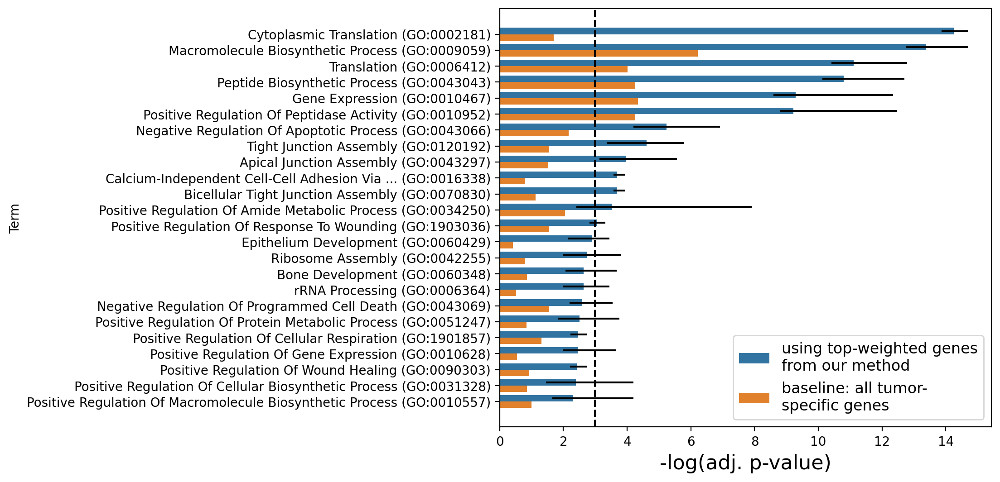

In [97]:
df = pd.read_csv(f'{results_path}/genes/{name}_selected_genes_sub.csv')
assert df['Term'].loc[9] == 'Calcium-Independent Cell-Cell Adhesion Via Plasma Membrane Cell-Adhesion Molecules (GO:0016338)'
df['Term'].loc[9] = 'Calcium-Independent Cell-Cell Adhesion Via ... (GO:0016338)'
df = df.set_index('Term')
df.columns = df.columns.map(lambda x: x.split('using')[1][1:])
df = df[df['selected genes'] <= 0.1]

mdf = pd.melt((-df.apply(np.log)).reset_index(), id_vars=['Term'], value_vars=['selected genes', 'all expressed genes'], value_name='-log(adj. p-value)')
mdf.loc[0:len(df)-1, 'low'] = mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'up'] = -mdf['-log(adj. p-value)']
mdf.loc[0:len(df)-1, 'low'] -= (-df[df.columns[:5]].max(axis=1).apply(np.log)).values
mdf.loc[0:len(df)-1, 'up'] += (-df[df.columns[:5]].min(axis=1).apply(np.log)).values
mdf.variable = mdf.variable.replace({'selected genes':'using top-weighted genes\nfrom our method',
                                     'all expressed genes':'baseline: all tumor-\nspecific genes'})

fig, ax = plt.subplots(dpi=200, figsize=(7, 6))
ax = sns.barplot(mdf, y='Term', x='-log(adj. p-value)', orient='h', hue='variable', ax=ax)

x_coords = [p.get_width() for p in ax.patches]
y_coords = [p.get_y() + 0.5 * p.get_height() for p in ax.patches]
ax.errorbar(x=x_coords, y=y_coords, xerr=mdf[['low', 'up']].values.T, fmt="none", c="k")

plt.gca().legend(fontsize=12).set_title('')
ax.set_xlabel('-log(adj. p-value)', fontsize=16)
plt.axvline(-np.log(0.05), color='k', ls='--')

## Compare ranks

In [88]:
name = '3515_Lkb1_T1_Fam'
seed = 19442
n_cells = 1000
results_path = f'./results/gamma/{gamma}'

gamma_paths = {
    1:'./results/gamma/1',
    5:'./results/gamma/5',
    10:'./results',
    20:'./results/gamma/20',
    100:'./results/gamma/100',
}

# Rank comparison to select genes
scores = pd.read_csv(f'{results_path}/scores/tumor/{name}_scores_sub_{seed}.csv', index_col='Unnamed: 0')
use_genes = ordered_genes = scores.index.values
gene_rank_df = pd.DataFrame(index=use_genes)

for gamma in [1, 5, 10, 20, 100]:
  gw_df = pd.read_csv(f'{gamma_paths[gamma]}/scores/tumor/{name}_gw_sub_{seed}.csv', index_col='Unnamed: 0')
  gene_rank_df[f'weight rank for gamma={gamma}'] = np.argsort(np.argsort(-gw_df.loc[use_genes]['weight']))
gene_rank_df

,weight rank for gamma=1,weight rank for gamma=5,weight rank for gamma=10,weight rank for gamma=20,weight rank for gamma=100
Sftpc,7,0,0,1,0
Clu,40,1,1,0,1
Krt19,9,4,3,3,3
Sftpb,12,2,2,2,2
Lyz2,5,3,4,5,4
...,...,...,...,...,...
Dhrs11,192,163,167,185,200
Dsn1,442,477,503,537,608
Atxn7l2,189,175,177,186,257
Pttg1,282,181,183,173,248


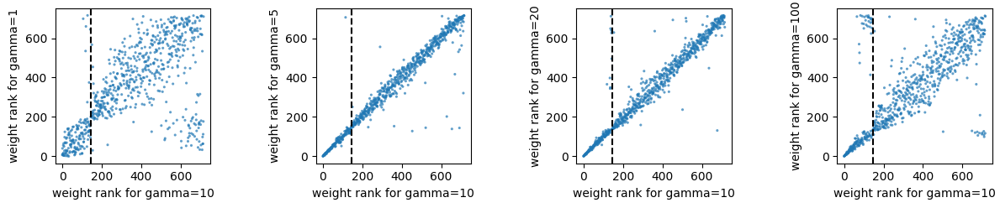

In [89]:
fig, axs = plt.subplots(1, 4, figsize=(12, 3))
for ax, gamma in zip(axs, [1, 5, 20, 100]):
  sns.scatterplot(gene_rank_df, x='weight rank for gamma=10', y=f'weight rank for gamma={gamma}', s=5,
                  edgecolor="none", alpha=0.7, ax=ax)
  ax.axvline(146, color='k', ls='--')
  ax.set_aspect(1)
fig.tight_layout(w_pad=5)